### Conexión a la BD de RDS

In [25]:
from pyclustering.cluster.kmedians import kmedians
from pyclustering.cluster import cluster_visualizer
from pyclustering.utils import read_sample
from pyclustering.samples.definitions import FCPS_SAMPLES

import datetime
import missingno as msno
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier,RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn import tree
from xgboost import XGBRegressor,XGBClassifier
import seaborn as sns
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import LabelBinarizer
import warnings
warnings.filterwarnings("ignore")
from sqlalchemy import create_engine, text
import scipy.stats as stats
#maximum number of rows to display
pd.options.display.max_rows = 20
import time
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import plotly.express as px
import matplotlib.gridspec as gridspec
import plotly.graph_objects as go
import plotly.figure_factory as ff


DB_USERNAME = 'damjimenezgu'
DB_PASSWORD = 'Analista1!' 
DB_ENDPOINT = 'ds4a-demo-instance.cqjr4hyu9xaq.us-east-1.rds.amazonaws.com' 
DB_NAME = 'desertion_pj_team67' 

engine=create_engine(f'postgresql://{DB_USERNAME}:{DB_PASSWORD}@{DB_ENDPOINT}/{DB_NAME}', max_overflow=20)

def runQuery(sql):
    result = engine.connect().execution_options(isolation_level="AUTOCOMMIT").execute((text(sql)))
    return pd.DataFrame(result.fetchall(), columns=result.keys())

### Pasar datos de RDS a pandas dataframe

In [30]:
start_time = time.time()

aux=runQuery("""select * from master_table_by_municipio limit 1;""")
all_vars=aux.columns
keep_vars_2016=['icbf_cobert_inmu_dtp_hep_1','icbf_cobert_inmu_tv_1','icbf_cobert_vacu_bcg_nac_v','icbf_cobert_vacu_fib_ama_1','icbf_cobert_vacu_haem_b_1','icbf_cobert_vacu_neumco_1','icbf_cobert_vacu_polio_1','icbf_cobert_vacu_rotav_1','icbf_num_afi_reg_contr_18','icbf_num_afi_reg_subs_18','icbf_num_nin_adol_desvinc','icbf_raz_mort_mater_x100m_nac_viv','icbf_tasa_fecun_nin_10_14','icbf_tasa_fecun_nin_15_19','icbf_tasa_mort_1_1000_nac_v','icbf_tasa_mort_fetal','icbf_tasa_mort_desnut_5','icbf_tasa_mort_eda_5','icbf_tasa_mort_era_5','icbf_num_afi_reg_contr_18_10mil','icbf_num_afi_reg_subs_18_10mil']
keep_vars_2017=['me_tamano_promedio_de_grupo','me_sedes_conectadas_a_internet']
keep_vars_2018=['pib_valor_agregado','pobr_ipm','pobr_imp_cabecera','pobr_ipm_cen_pobl','pib_valor_agregado_10mil']

vars_remove=keep_vars_2016+keep_vars_2017+keep_vars_2018
keep_vars_1=all_vars.drop(vars_remove)
keep_vars_1='A.'+',A.'.join(keep_vars_1)
keep_vars_2='B.'+',B.'.join(keep_vars_2016)
keep_vars_3='C.'+',C.'.join(keep_vars_2017)
keep_vars_4='D.'+',D.'.join(keep_vars_2018)


mun = runQuery("""
select """+keep_vars_1+""","""+keep_vars_2+""","""+keep_vars_3+""","""+keep_vars_4+""" from master_table_by_municipio A 
LEFT JOIN (select * from master_table_by_municipio where year_cohort = 2016 and desertion_perc is not null) B
on A.code_municip= B.code_municip
LEFT JOIN (select * from master_table_by_municipio where year_cohort = 2017 and desertion_perc is not null) C
on A.code_municip= C.code_municip
LEFT JOIN (select * from master_table_by_municipio where year_cohort = 2018 and desertion_perc is not null) D
on A.code_municip= D.code_municip
where A.year_cohort = 2019 and A.desertion_perc is not null;""")

vars_convert=['dane_alu_01','dane_alu_02','dane_alu_04','dane_alu_05','dane_alu_06','dane_alu_07','dane_alu_08','dane_alu_09','dane_alu_10','dane_alu_11','dane_alu_12','dane_alu_13','dane_alu_14','dane_alu_15','dane_alu_16','dane_alu_17','dane_alu_18','dane_alu_19','dane_alu_20','dane_alu_21','dane_alu_22','dane_alu_23','dane_alu_24','dane_alu_25','dane_doc_01','dane_doc_02','dane_doc_03','dane_doc_04','dane_doc_05','dane_doc_06','dane_doc_07','dane_doc_08','dane_doc_09','dane_doc_10','dane_doc_11','dane_doc_12','dane_doc_13','dane_doc_14','dane_doc_15','dane_doc_16','dane_doc_17','dane_doc_18','dane_doc_19','dane_doc_20','dane_doc_21','dane_doc_22','dane_doc_23','dane_doc_24','dane_doc_25','dane_doc_26','dane_doc_27']

for col in vars_convert:
        mun[col] = mun[col].astype(np.float64)
        
print("Ejecución: %s seconds" % (time.time() - start_time))

Ejecución: 14.965497732162476 seconds


 ### Revisar datos faltantes

Ejecución: 1.220252513885498 seconds


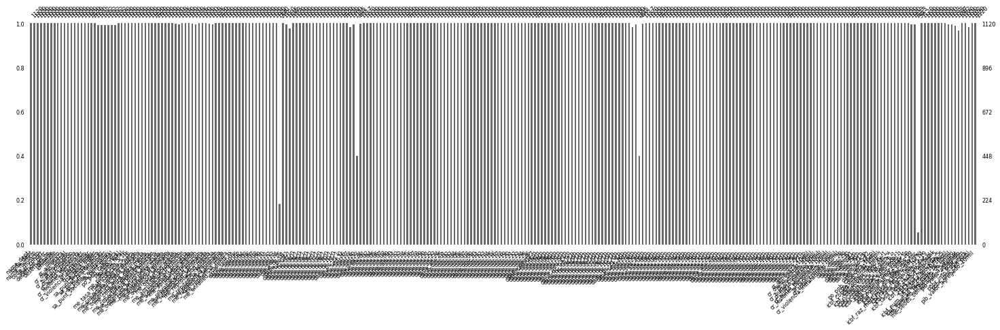

In [3]:
start_time = time.time()
msno.bar(mun, labels=True, figsize=(25,6), fontsize=8)
print("Ejecución: %s seconds" % (time.time() - start_time))

In [4]:
def full_describe(dataframe,variables="all",variabilidad=20,completitud=10): #summary, univariado, describe, analisis descriptivo, describir, analisis exploratorio
    #Descripcion de los parametros:
    #dataframe: Tabla a usar en formato DataFrame
    #variables: variables sobre las que se va a calcular el describe. Formas posibles: "all", ingresar secuencia (ie. '1:8'), 
    #ingresar lista de numeros o de nombres de variables (ie. '1,4,9' o 'var1,var2,var3')
    #completitud: Minimo de completitud aceptada por variable (valor entre 0 y 100)
    #variabilidad: Minimo de variabilidad aceptada por variable (0,2,10,20,50,100)
    print("Inicia calculo del describe, Hora: "+ datetime.datetime.now().strftime("%H:%M:%S"))
    start1 = datetime.datetime.now()
    if variables == "all": #Si se desea analisis para todas las variables
        #Calcular describe y adicionar (concatenar) filas con Missing
        resumen=pd.concat([dataframe.describe(include="all",percentiles =[0,0.01,0.05,0.1,0.25,0.5,0.75,0.9,0.95,0.99,1]), dataframe.isnull().sum().to_frame(name = 'missing').T],sort=False)
    elif ":" in variables: #Si se desea analisis para secuencia de variables n1:n2
        #Calcular describe y adicionar (concatenar) filas con Missing
        variables_serie=list(pd.to_numeric((variables).split(':')))
        variables_serie=list(pd.Series(range(variables_serie[0],variables_serie[1])))
        resumen=pd.concat([dataframe.iloc[:,variables_serie].describe(include="all",percentiles =[0,0.01,0.05,0.1,0.25,0.5,0.75,0.9,0.95,0.99,1]), dataframe.iloc[:,variables_serie].isnull().sum().to_frame(name = 'missing').T],sort=False)
    else:
        try: #Si se desea analisis para array numerico (posiciones) de variables [n1,n2,n3,...]
            # Dividir valor de variables por coma, creando lista numerica
            variables_serie=list(pd.to_numeric((variables).split(',')))
            #Calcular describe y adicionar (concatenar) filas con Missing
            resumen=pd.concat([dataframe.iloc[:,variables_serie].describe(include="all",percentiles =[0,0.01,0.05,0.1,0.25,0.5,0.75,0.9,0.95,0.99,1]), dataframe.iloc[:,variables_serie].isnull().sum().to_frame(name = 'missing').T],sort=False)
        except: 
            if set(list(variables.split(","))).issubset(list(dataframe.columns)): #Si se desea analisis para array string (nombres de campos) de variables ['nom1','nom2','nom3',...]
                # Dividir valor de variables por coma, creando lista de cadena de texto
                variables_serie=list(variables.split(","))
                #Calcular describe y adicionar (concatenar) filas con Missing
                resumen=pd.concat([dataframe.loc[:,variables_serie].describe(include="all",percentiles =[0,0.01,0.05,0.1,0.25,0.5,0.75,0.9,0.95,0.99,1]), dataframe.loc[:,variables_serie].isnull().sum().to_frame(name = 'missing').T],sort=False)
            else: #Garbage Collector para casos diferentes
                resumen="Invalid entry for variables"
                
    print("Finaliza calculo del describe. Tiempo transcurrido: "+str((datetime.datetime.now() - start1).seconds)+" segs")
    
    start2 = datetime.datetime.now()
    print("Inicia calculo de completitud y variabilidad, Hora: "+ datetime.datetime.now().strftime("%H:%M:%S"))
    if isinstance(resumen, pd.DataFrame)==True: #Verificar si existe algun error en los parametros ingresados
        #Calcular cantidad total
        resumen.loc['total count']=resumen.loc[['count','missing']].sum()
        #Calcular porcentaje de missing
        resumen.loc['% missing']=np.around((resumen.loc['missing']*100/resumen.loc['total count']).astype(np.double),4)
        #Trasponer para usar de mejor forma el codigo
        resumen=resumen.T
        #Calcular variabilidad
        resumen['variabilidad'] = np.where(resumen['min']==resumen['max'], '00_variacion', 
                                           np.where(resumen['1%']==resumen['99%'], '02_variacion', 
                                                   np.where(resumen['5%']==resumen['95%'], '10_variacion', 
                                                           np.where(resumen['10%']==resumen['90%'], '20_variacion', 
                                                                   np.where(resumen['25%']==resumen['75%'], '50_variacion', 
                                                                           'variabilidad_alta')))))
        if variabilidad == 0:
            resumen['decision_variabilidad'] = "aceptar"
        elif variabilidad == 2:
            resumen['decision_variabilidad'] = np.where(resumen['variabilidad']=='00_variacion', 'rechazar',
                                                        'aceptar')
        elif variabilidad == 10:
            resumen['decision_variabilidad'] = np.where((resumen['variabilidad']=='00_variacion') | (resumen['variabilidad']=='02_variacion'), 'rechazar',
                                                        'aceptar')
        elif variabilidad == 20:
            resumen['decision_variabilidad'] = np.where((resumen['variabilidad']=='00_variacion') | (resumen['variabilidad']=='02_variacion') | (resumen['variabilidad']=='10_variacion'), 'rechazar',
                                                        'aceptar')
        elif variabilidad == 50:
            resumen['decision_variabilidad'] = np.where((resumen['variabilidad']=='00_variacion') | (resumen['variabilidad']=='02_variacion') | (resumen['variabilidad']=='10_variacion') | (resumen['variabilidad']=='20_variacion'), 'rechazar',
                                                        'aceptar')
        elif variabilidad == 100: 
            resumen['decision_variabilidad'] = np.where((resumen['variabilidad']=='00_variacion') | (resumen['variabilidad']=='02_variacion') | (resumen['variabilidad']=='10_variacion') | (resumen['variabilidad']=='20_variacion') | (resumen['variabilidad']=='50_variacion'), 'rechazar',
                                                        'aceptar')
        else:
            resumen['decision_variabilidad']="VALOR NO VALIDO"
            print("Invalid entry for parameter variabilidad")
        #Calcular completitud
        resumen['decision_completitud']=np.where(resumen['% missing']==0,'aceptar_100',
                                                 np.where(resumen['% missing']>completitud, 'rechazar','aceptar')) 
    else:
        resumen="Invalid entry for variables"
        
    print("Finaliza calculo de completitud y variabilidad. Tiempo transcurrido: "+str((datetime.datetime.now() - start2).seconds)+" segs")
    
    
    print("Finaliza calculo del proceso completo. Tiempo transcurrido total: "+str((datetime.datetime.now() - start1).seconds)+" segs")
    return resumen

In [5]:
#Invocar funcion
resumen=full_describe(dataframe=mun,variabilidad=20,completitud=30)
resumen.to_clipboard(index=True,header=True)

Inicia calculo del describe, Hora: 19:31:37
Finaliza calculo del describe. Tiempo transcurrido: 0 segs
Inicia calculo de completitud y variabilidad, Hora: 19:31:38
Finaliza calculo de completitud y variabilidad. Tiempo transcurrido: 0 segs
Finaliza calculo del proceso completo. Tiempo transcurrido total: 0 segs


### Rankear deserción usando DBScan

In [6]:
start_time = time.time()
vars_keep=['desertion_perc', 'desertion_no','me_cobertura_neta']
X=mun[vars_keep].copy()
X['desertion_no_log']=np.log(X['desertion_no'])
X['desertion_no_log']=X['desertion_no_log'].replace([np.inf, -np.inf], np.nan)
X['desertion_no_log']=X['desertion_no_log'].fillna(X['desertion_no_log'].min())

vars_keep_trans=['desertion_perc', 'desertion_no_log','me_cobertura_neta']
X_train=X[vars_keep_trans]

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_train)

dbscan = DBSCAN(eps=0.2, min_samples = 2)
clusters = pd.Series(dbscan.fit_predict(X_scaled))
print(clusters.value_counts())

X_scaled = pd.DataFrame(X_scaled)
X_scaled.columns = [sub + "_std" for sub in vars_keep_trans]
X=pd.concat([X,X_scaled],axis=1)
X = pd.concat([X, clusters], axis=1)
X = pd.concat([X, mun['name_municip']], axis=1)
X.rename(columns={0: "deser_perc_rank"},inplace=True)

fig = px.scatter(X, x="desertion_no_log", y="desertion_perc", color="deser_perc_rank",width=700,height =500,hover_name='name_municip')
fig.show()

fig = px.scatter(X, x="me_cobertura_neta", y="desertion_perc", color="deser_perc_rank",width=700,height =500,hover_name='name_municip')
fig.show()
print("Ejecución: %s seconds" % (time.time() - start_time))

-1      390
 1      314
 19      10
 12      10
 6        9
       ... 
 95       2
 93       2
 56       2
 57       2
 134      2
Length: 137, dtype: int64


Ejecución: 19.854538917541504 seconds


### Rankear deserción usando Kmeans

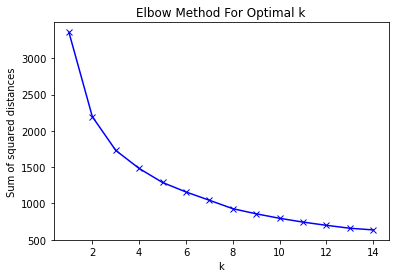

Ejecución: 16.187692880630493 seconds


In [28]:
start_time = time.time()

vars_keep=['desertion_perc', 'desertion_no','me_cobertura_neta']
X=mun[vars_keep].copy()
X['desertion_no_log']=np.log(X['desertion_no'])
X['desertion_no_log']=X['desertion_no_log'].replace([np.inf, -np.inf], np.nan)
X['desertion_no_log']=X['desertion_no_log'].fillna(X['desertion_no_log'].min())
vars_keep_trans=['desertion_perc', 'desertion_no_log','me_cobertura_neta']
X_train=X[vars_keep_trans]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_train)
#X_scaled = X_train

#Número de clusters óptimo
Sum_of_squared_distances = []
K = range(1,15)
for k in K:
    km = KMeans(n_clusters=k, random_state=12345)
    km = km.fit(X_scaled)
    Sum_of_squared_distances.append(km.inertia_)

plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum of squared distances')
plt.title('Elbow Method For Optimal k')
plt.show()
print("Ejecución: %s seconds" % (time.time() - start_time))

### Kmeans con 3 grupos y 3 variables

1_Alta     427
2_Media    415
3_Baja     278
Name: deser_perc_rank, dtype: int64
Inercia: 1730.9428731178996
Ejecución: 0.4366466999053955 seconds


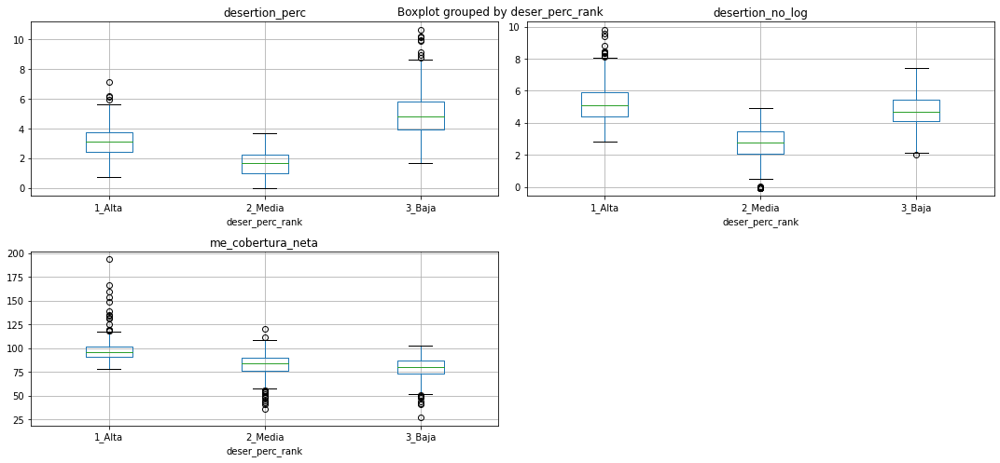

In [10]:
vars_keep=['desertion_perc', 'desertion_no','me_cobertura_neta']
X=mun[vars_keep].copy()
X['desertion_no_log']=np.log(X['desertion_no'])
X['desertion_no_log']=X['desertion_no_log'].replace([np.inf, -np.inf], np.nan)
X['desertion_no_log']=X['desertion_no_log'].fillna(X['desertion_no_log'].min())
vars_keep_trans=['desertion_perc', 'desertion_no_log','me_cobertura_neta']
X_train=X[vars_keep_trans]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_train)
#X_scaled=X_train

start_time = time.time()
#Ajustar Kmeans con 3 grupos
km = KMeans(n_clusters=3, random_state=12345).fit(X_scaled)
clusters=pd.Series(km.labels_)


X_scaled = pd.DataFrame(X_scaled)
X_scaled.columns = [sub + "_std" for sub in vars_keep_trans]
X=pd.concat([X,X_scaled],axis=1)
X = pd.concat([X, clusters], axis=1)
X = pd.concat([X, mun['name_municip']], axis=1)
X.rename(columns={0: "deser_perc_rank"},inplace=True)

X['deser_perc_rank']=np.where(X['deser_perc_rank'] == 2, '3_Baja'
                                       , np.where(X['deser_perc_rank'] == 0, '1_Alta'
                                                  , np.where(X['deser_perc_rank'] == 1,'2_Media','0')))

bp_vars=vars_keep_trans+['deser_perc_rank']
fig, axes = plt.subplots(2,2,figsize=(15,7)) # create figure and axes

for i,el in enumerate(list(X[bp_vars].columns.values)[:-1]):
    a = X[bp_vars].boxplot(el, by="deser_perc_rank", ax=axes.flatten()[i])

fig.delaxes(axes[1,1]) # remove empty subplot
plt.tight_layout() 

print(X['deser_perc_rank'].value_counts())
print("Inercia: "+str(km.inertia_))
print("Ejecución: %s seconds" % (time.time() - start_time))

### Kmeans con 4 grupos y 2 variables

2_DS_Baja-CB_Baja    363
3_DS_Baja-CB_Alta    347
4_DS_Alta-CB_Alta    342
1_DS_Alta-CB_Baja     68
Name: deser_perc_rank, dtype: int64
Inercia: 894.1165632876591


Ejecución: 0.643338680267334 seconds


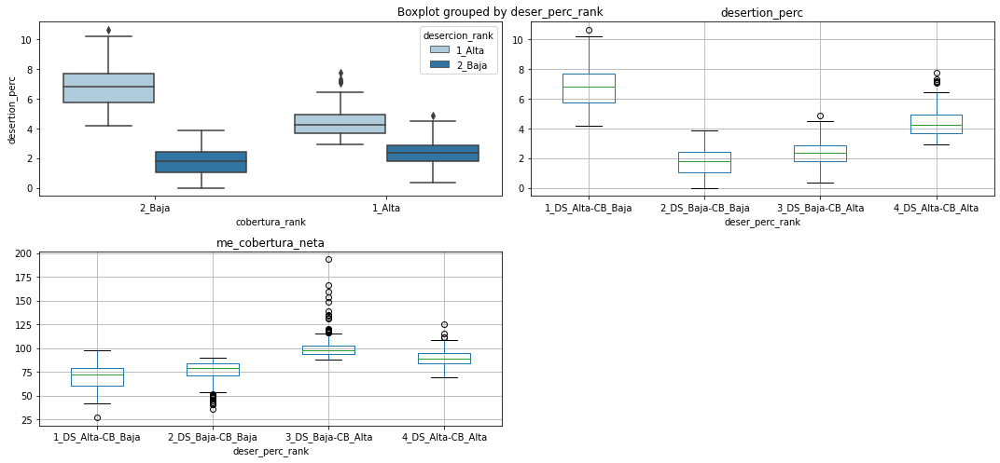

In [23]:
vars_keep=['desertion_perc', 'me_cobertura_neta']
X=mun[vars_keep].copy()
vars_keep_trans=['desertion_perc', 'me_cobertura_neta']
X_train=X[vars_keep_trans]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_train)
#X_scaled=X_train

start_time = time.time()
#Ajustar Kmeans con 4 grupos
km = KMeans(n_clusters=4, random_state=12345).fit(X_scaled)
clusters=pd.Series(km.labels_)

X_scaled = pd.DataFrame(X_scaled)
X_scaled.columns = [sub + "_std" for sub in vars_keep_trans]
X=pd.concat([X,X_scaled],axis=1)
X = pd.concat([X, clusters], axis=1)
X = pd.concat([X, mun['name_municip']], axis=1)
X.rename(columns={0: "deser_perc_rank"},inplace=True)

X['deser_perc_rank']=np.where(X['deser_perc_rank'] == 2, '1_DS_Alta-CB_Baja'
                                       , np.where(X['deser_perc_rank'] == 0, '3_DS_Baja-CB_Alta'
                                                  , np.where(X['deser_perc_rank'] == 3, '2_DS_Baja-CB_Baja'
                                                             , np.where(X['deser_perc_rank'] == 1, '4_DS_Alta-CB_Alta',''))))

X['cobertura_rank']=np.where(X['deser_perc_rank'].str.slice(10,17).isin(['CB_Baja']),'2_Baja','1_Alta')
X['desercion_rank']=np.where(X['deser_perc_rank'].str.slice(2,9).isin(['DS_Baja']),'2_Baja','1_Alta')

bp_vars=vars_keep_trans+['deser_perc_rank']
fig, axes = plt.subplots(2,2,figsize=(15,7)) # create figure and axes
ax = sns.boxplot(x="cobertura_rank", y="desertion_perc", hue="desercion_rank",data=X, palette="Paired",ax=axes.flatten()[0])
for i,el in enumerate(list(X[bp_vars].columns.values)[:-1]):
    a = X[bp_vars].boxplot(el, by="deser_perc_rank", ax=axes.flatten()[i+1])

fig.delaxes(axes[1,1]) # remove empty subplot


plt.tight_layout() 

print(X['deser_perc_rank'].value_counts())
print("Inercia: "+str(km.inertia_))
fig = px.scatter(X, x="me_cobertura_neta", y="desertion_perc", color="deser_perc_rank",width=700,height =500,hover_name='name_municip')
fig.show()
print("Ejecución: %s seconds" % (time.time() - start_time))

### Kmeans con 4 grupos y 3 variables

Ejecución: 2.704035758972168 seconds
2_DS_Baja-CB_Alta    355
1_DS_Baja-CB_Baja    270
4_DS_Alta-CB_Alta    253
3_DS_Alta-CB_Baja    242
Name: deser_perc_rank, dtype: int64
Inercia: 1481.6875022177153


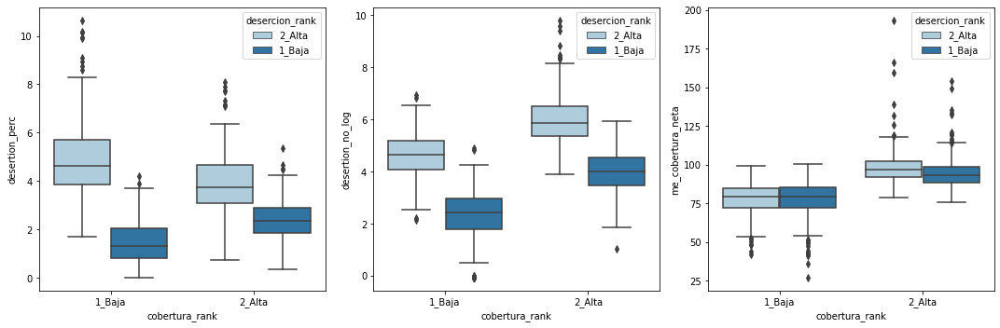

In [29]:
#Ajustar Kmeans con 4 grupos y 3 variables
vars_keep=['desertion_perc', 'desertion_no','me_cobertura_neta']
X=mun[vars_keep].copy()
X['desertion_no_log']=np.log(X['desertion_no'])
X['desertion_no_log']=X['desertion_no_log'].replace([np.inf, -np.inf], np.nan)
X['desertion_no_log']=X['desertion_no_log'].fillna(X['desertion_no_log'].min())
vars_keep_trans=['desertion_perc', 'desertion_no_log','me_cobertura_neta']
X_train=X[vars_keep_trans]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_train)
#X_scaled=X_train

start_time = time.time()
#Ajustar Kmeans con 4 grupos
km = KMeans(n_clusters=4, random_state=12345).fit(X_scaled)
clusters=pd.Series(km.labels_)

X_scaled = pd.DataFrame(X_scaled)
X_scaled.columns = [sub + "_std" for sub in vars_keep_trans]
X=pd.concat([X,X_scaled],axis=1)
X = pd.concat([X, clusters], axis=1)
X = pd.concat([X, mun['name_municip']], axis=1)
X.rename(columns={0: "deser_perc_rank_aux"},inplace=True)

ranks=X.groupby(['deser_perc_rank_aux'])['desertion_perc','me_cobertura_neta'].mean().reset_index()
ranks=ranks.sort_values(by=['desertion_perc']).reset_index()
ranks['des_flag']=[0,0,1,1]
ranks=ranks.sort_values(by=['me_cobertura_neta']).reset_index()
ranks['cob_flag']=[0,0,1,1]
ranks
def flag_df(df):

    if (df['des_flag'] == 0) and (df['cob_flag'] == 0):
        return '1_DS_Baja-CB_Baja'
    elif (df['des_flag'] == 0) and (df['cob_flag'] == 1):
        return '2_DS_Baja-CB_Alta'
    elif (df['des_flag'] == 1) and (df['cob_flag'] == 0):
        return '3_DS_Alta-CB_Baja'
    elif (df['des_flag'] == 1) and (df['cob_flag'] == 1):
        return '4_DS_Alta-CB_Alta'

ranks['deser_perc_rank'] = ranks.apply(flag_df, axis = 1)

X=pd.merge(left=X, right=ranks, left_on='deser_perc_rank_aux', right_on='deser_perc_rank_aux',how='left')
X=X.drop(['desertion_perc_y', 'me_cobertura_neta_y', 'des_flag', 'cob_flag','deser_perc_rank_aux','level_0','index'], axis=1)
X.rename(columns = {'desertion_perc_x':'desertion_perc','me_cobertura_neta_x':'me_cobertura_neta'}, inplace = True) 


X['cobertura_rank']=np.where(X['deser_perc_rank'].str.slice(10,17).isin(['CB_Baja']),'1_Baja','2_Alta')
X['desercion_rank']=np.where(X['deser_perc_rank'].str.slice(2,9).isin(['DS_Baja']),'1_Baja','2_Alta')

bp_vars=vars_keep_trans+['deser_perc_rank']
fig, axes = plt.subplots(1,3,figsize=(15,5)) # create figure and axes

ax = sns.boxplot(x="cobertura_rank", y="desertion_perc", hue="desercion_rank",data=X, palette="Paired",ax=axes.flatten()[0])
ax = sns.boxplot(x="cobertura_rank", y="desertion_no_log", hue="desercion_rank",data=X, palette="Paired",ax=axes.flatten()[1])
ax = sns.boxplot(x="cobertura_rank", y="me_cobertura_neta", hue="desercion_rank",data=X, palette="Paired",ax=axes.flatten()[2])

# fig.delaxes(axes[1,1]) # remove empty subplot


plt.tight_layout() 


print("Ejecución: %s seconds" % (time.time() - start_time))

print(X['deser_perc_rank'].value_counts())
print("Inercia: "+str(km.inertia_))

fig = px.scatter_3d(X, x="desertion_no_log", y="me_cobertura_neta", z="desertion_perc", color="deser_perc_rank",hover_name="name_municip")
fig.show()

fig = px.scatter(X, x="desertion_no_log", y="desertion_perc", color="deser_perc_rank",width=700,height =500,hover_name='name_municip')
fig.show()

fig = px.scatter(X, x="me_cobertura_neta", y="desertion_perc", color="deser_perc_rank",width=700,height =500,hover_name='name_municip')
fig.show()


In [11]:
mun['deser_perc_rank']=X['deser_perc_rank']
mun['cobertura_rank']=X['cobertura_rank']
mun['desercion_rank']=X['desercion_rank']
   
a=mun.loc[mun['deser_perc_rank']=="1_DS_Baja-CB_Baja"]['desertion_perc']
b=mun.loc[mun['deser_perc_rank']=="2_DS_Baja-CB_Alta"]['desertion_perc']
c=mun.loc[mun['deser_perc_rank']=="3_DS_Alta-CB_Baja"]['desertion_perc']
d=mun.loc[mun['deser_perc_rank']=="4_DS_Alta-CB_Alta"]['desertion_perc']
fvalue, pvalue =stats.kruskal(a,b,c,d)
print("desertion_perc test: F-value",fvalue,"P-value", pvalue)

a=mun.loc[mun['deser_perc_rank']=="1_DS_Baja-CB_Baja"]['desertion_no']
b=mun.loc[mun['deser_perc_rank']=="2_DS_Baja-CB_Alta"]['desertion_no']
c=mun.loc[mun['deser_perc_rank']=="3_DS_Alta-CB_Baja"]['desertion_no']
d=mun.loc[mun['deser_perc_rank']=="4_DS_Alta-CB_Alta"]['desertion_no']
fvalue, pvalue =stats.kruskal(a,b,c,d)
print("desertion_no test: F-value",fvalue,"P-value", pvalue)

a=mun.loc[mun['deser_perc_rank']=="1_DS_Baja-CB_Baja"]['me_cobertura_neta']
b=mun.loc[mun['deser_perc_rank']=="2_DS_Baja-CB_Alta"]['me_cobertura_neta']
c=mun.loc[mun['deser_perc_rank']=="3_DS_Alta-CB_Baja"]['me_cobertura_neta']
d=mun.loc[mun['deser_perc_rank']=="4_DS_Alta-CB_Alta"]['me_cobertura_neta']
fvalue, pvalue =stats.kruskal(a,b,c,d)
print("me_cobertura_neta test: F-value",fvalue,"P-value", pvalue)


desertion_perc test: F-value 726.9822728029574 P-value 2.958716664123334e-157
desertion_no test: F-value 790.0401488652916 P-value 6.255683205340705e-171
me_cobertura_neta test: F-value 604.7429374140904 P-value 9.444554868375508e-131


# Ajuste de árbol de decisión 
### Feature selection

Ejecución: 0.9335262775421143 seconds


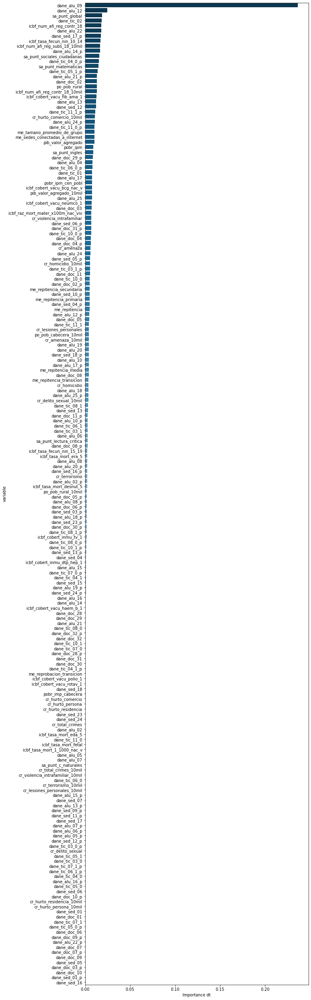

In [18]:
start_time = time.time()
#Imputar valores faltantes
mun_nomiss=mun.copy()
mun_nomiss=mun_nomiss.fillna(mun_nomiss.median())

vars_drop = list(['name_dept', 'code_dept', 'name_municip', 'code_municip', 'year_cohort'
                  ,'desertion_perc', 'desertion_no', 'latitude', 'longitude', 'region','deser_perc_rank', 'cobertura_rank', 'desercion_rank'
                  ,'me_cobertura_neta'
                  ,'me_desercion_transicion','me_desercion_primaria','me_desercion_secundaria','me_desercion_media'
#Variables con alto missing (mas de 30%)
                  ,'dane_sed_20','dane_sed_20_p','dane_sed_14','icbf_num_nin_adol_desvinc'
#Variables de escalafon docente que se cambiaron por nueva agrupacion (Luis)
                  ,'dane_doc_12_p','dane_doc_13_p','dane_doc_14_p','dane_doc_15_p','dane_doc_16_p','dane_doc_17_p','dane_doc_18_p','dane_doc_19_p','dane_doc_20_p','dane_doc_21_p','dane_doc_22_p','dane_doc_23_p','dane_doc_24_p','dane_doc_25_p','dane_doc_26_p','dane_doc_27_p','dane_doc_12','dane_doc_13','dane_doc_14','dane_doc_15','dane_doc_16','dane_doc_17','dane_doc_18','dane_doc_19','dane_doc_20','dane_doc_21','dane_doc_22','dane_doc_23','dane_doc_24','dane_doc_25','dane_doc_26','dane_doc_27'
#Eliminadas por seleccion una a una:
                  ,'me_reprobacion','me_aprobacion','me_tasa_matriculacion_5_16','me_aprobacion_transicion','dane_alu_11','me_aprobacion_primaria','me_cobertura_bruta','po_pob_total','me_cobertura_neta_secundaria','me_cobertura_neta_primaria','me_aprobacion_secundaria','icbf_num_afi_reg_subs_18','me_aprobacion_media','me_cobertura_bruta_secundaria','dane_sed_10','po_pob_cabecera','me_cobertura_bruta_primaria','me_enrolled_students_n','dane_alu_11_p','dane_alu_09_p','me_poblacion_5_16','dane_sed_03','me_reprobacion_secundaria','dane_sed_08','me_cobertura_bruta_media','me_reprobacion_media','dane_sed_09','dane_alu_23','dane_alu_23_p','me_cobertura_neta_media','dane_alu_01','me_cobertura_neta_transicion','me_cobertura_bruta_transicion','dane_sed_02_p','dane_sed_11','dane_sed_02','me_reprobacion_primaria'

])

X_all=mun_nomiss.drop(vars_drop, axis=1)

y=mun_nomiss['deser_perc_rank']

clf = DecisionTreeClassifier(random_state=12345)
clf = clf.fit(X_all, y)
features_imp_dt=dict(zip(X_all.columns, clf.feature_importances_))
features_imp_dt=pd.DataFrame.from_dict(features_imp_dt, orient='index').reset_index()
features_imp_dt.rename(columns={'index':'variable',0:'Importance dt'},inplace=True)
features_imp_dt=features_imp_dt.sort_values(by='Importance dt', ascending=False)
features_imp_dt.to_clipboard(index=False,header=True)

plt.figure(figsize=(10,45))
ax = sns.barplot(x="Importance dt", y="variable", data=features_imp_dt,palette="PuBu_r")

print("Ejecución: %s seconds" % (time.time() - start_time))

### Ajuste del modelo

In [19]:
start_time = time.time()
feature_cols = ['dane_alu_09','dane_alu_12','sa_punt_global','dane_alu_22','dane_tic_05_1_p','dane_doc_02_p','po_pob_rural','sa_punt_matematicas','dane_sed_17_p','dane_tic_11_1_p']

X = X_all[feature_cols]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=12345)
clf = DecisionTreeClassifier(max_depth=3)
clf = clf.fit(X_train,y_train)
y_pred_train = clf.predict(X_train)
y_pred_test = clf.predict(X_test)
def multiclass_roc_auc_score(y_test, y_pred, average="macro"):
    lb = LabelBinarizer()
    lb.fit(y_test)
    y_test = lb.transform(y_test)
    y_pred = lb.transform(y_pred)
    return metrics.roc_auc_score(y_test, y_pred, average=average)
print("AUROC train:",multiclass_roc_auc_score(y_train,y_pred_train))
print("AUROC test:",multiclass_roc_auc_score(y_test,y_pred_test))
print("Accuracy train:",metrics.accuracy_score(y_train, y_pred_train))
print("Accuracy test:",metrics.accuracy_score(y_test, y_pred_test))
print("Recall (Sensitivity) train:",metrics.recall_score(y_train, y_pred_train, average=None))
print("Recall (Sensitivity) test:",metrics.recall_score(y_test, y_pred_test, average=None))
print("F1 Score train:",metrics.f1_score(y_train, y_pred_train, average=None))
print("F1 Score test:",metrics.f1_score(y_test, y_pred_test, average=None))
pd.DataFrame(metrics.confusion_matrix(y_pred_test,y_test)).to_clipboard(index=True,header=True)
print("Ejecución: %s seconds" % (time.time() - start_time))

AUROC train: 0.7250487373622141
AUROC test: 0.6984345124377329
Accuracy train: 0.5770089285714286
Accuracy test: 0.5357142857142857
Recall (Sensitivity) train: [0.60189573 0.43462898 0.60204082 0.72330097]
Recall (Sensitivity) test: [0.55932203 0.40277778 0.5        0.74468085]
F1 Score train: [0.62871287 0.50204082 0.47484909 0.74314214]
F1 Score test: [0.60550459 0.4496124  0.42201835 0.69306931]
Ejecución: 0.053853750228881836 seconds


# Ajuste de XG-Boost
### Feature selection

Ejecución: 4.807142019271851 seconds


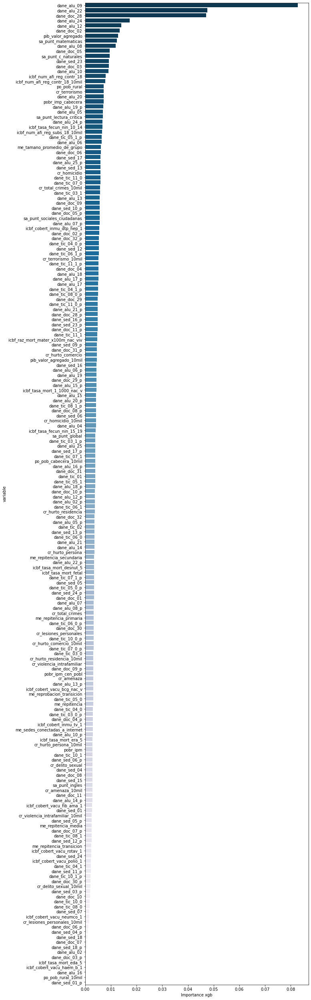

In [20]:
start_time = time.time()
X_all=mun_nomiss.drop(vars_drop, axis=1)

y=mun_nomiss['deser_perc_rank']

# define the model
xgb_model = XGBClassifier(random_state=12345)
# fit the model
xgb_model =xgb_model.fit(X_all, y)
# get importance
 
features_imp_xgb=dict(zip(X_all.columns, xgb_model.feature_importances_))
features_imp_xgb=pd.DataFrame.from_dict(features_imp_xgb, orient='index').reset_index()
features_imp_xgb.rename(columns={'index':'variable',0:'Importance xgb'},inplace=True)
features_imp_xgb=features_imp_xgb.sort_values(by='Importance xgb', ascending=False)
features_imp_xgb.to_clipboard(index=False,header=True)

plt.figure(figsize=(10,45))
ax = sns.barplot(x="Importance xgb", y="variable", data=features_imp_xgb,palette="PuBu_r")
print("Ejecución: %s seconds" % (time.time() - start_time))

### Ajuste del modelo

In [21]:
start_time = time.time()
feature_cols = ['dane_alu_09','dane_doc_28','dane_alu_22','dane_alu_24','cr_terrorismo_10mil','dane_alu_12','cr_terrorismo','dane_doc_05','dane_doc_32','sa_punt_matematicas']


X = X_all[feature_cols]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=12345)

xgb1 = XGBClassifier(random_state=12345)
parameters = {'max_depth':range(3,10,2),
    'min_child_weight':range(1,6,2),
    'learning_rate': [0.0001, 0.001, 0.01, 0.1, 0.2]}

xgb_grid = GridSearchCV(xgb1,parameters,cv = 5,n_jobs = -1,verbose=False)

xgb_grid.fit(X_train,y_train)

print(xgb_grid.best_score_)
print(xgb_grid.best_params_)
print("Ejecución: %s seconds" % (time.time() - start_time))

0.5669397889509622
{'learning_rate': 0.0001, 'max_depth': 3, 'min_child_weight': 5}
Ejecución: 54.36888837814331 seconds


In [22]:
start_time = time.time()
X = X_all[feature_cols]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=12345)
xgb = XGBClassifier(random_state=12345,learning_rate=0.001,max_depth=3,min_child_weight=5)
xgb = xgb.fit(X_train,y_train)
y_pred_train = xgb.predict(X_train)
y_pred_test = xgb.predict(X_test)
def multiclass_roc_auc_score(y_test, y_pred, average="macro"):
    lb = LabelBinarizer()
    lb.fit(y_test)
    y_test = lb.transform(y_test)
    y_pred = lb.transform(y_pred)
    return metrics.roc_auc_score(y_test, y_pred, average=average)
print("AUROC train:",multiclass_roc_auc_score(y_train,y_pred_train))
print("AUROC test:",multiclass_roc_auc_score(y_test,y_pred_test))
print("Accuracy train:",metrics.accuracy_score(y_train, y_pred_train))
print("Accuracy test:",metrics.accuracy_score(y_test, y_pred_test))
print("Recall (Sensitivity) train:",metrics.recall_score(y_train, y_pred_train, average=None))
print("Recall (Sensitivity) test:",metrics.recall_score(y_test, y_pred_test, average=None))
print("F1 Score train:",metrics.f1_score(y_train, y_pred_train, average=None))
print("F1 Score test:",metrics.f1_score(y_test, y_pred_test, average=None))
pd.DataFrame(metrics.confusion_matrix(y_pred_test,y_test)).to_clipboard(index=True,header=True)
print("Ejecución: %s seconds" % (time.time() - start_time))

AUROC train: 0.735667066802414
AUROC test: 0.6989858924946268
Accuracy train: 0.6149553571428571
Accuracy test: 0.5580357142857143
Recall (Sensitivity) train: [0.71563981 0.68904594 0.31632653 0.69417476]
Recall (Sensitivity) test: [0.61016949 0.56944444 0.30434783 0.72340426]
F1 Score train: [0.67111111 0.60653188 0.3974359  0.73901809]
F1 Score test: [0.62608696 0.4969697  0.38888889 0.70833333]
Ejecución: 0.452786922454834 seconds


# Ajuste de Random Forest
### Feature selection

Ejecución: 1.30234694480896 seconds


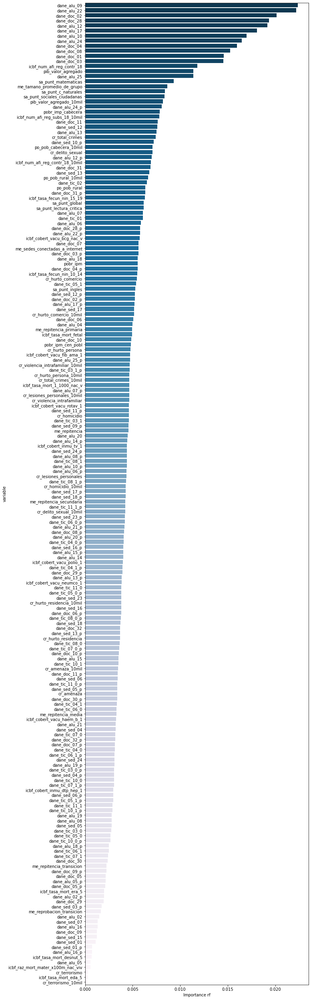

In [23]:
start_time = time.time()
X_all=mun_nomiss.drop(vars_drop, axis=1)

y=mun_nomiss['deser_perc_rank']

# define the model
rf_model = RandomForestClassifier(random_state=12345)
# fit the model
rf_model = rf_model.fit(X_all, y)
# get importance
 
features_imp_rf=dict(zip(X_all.columns, rf_model.feature_importances_))
features_imp_rf=pd.DataFrame.from_dict(features_imp_rf, orient='index').reset_index()
features_imp_rf.rename(columns={'index':'variable',0:'Importance rf'},inplace=True)
features_imp_rf=features_imp_rf.sort_values(by='Importance rf', ascending=False)
features_imp_rf.to_clipboard(index=False,header=True)

plt.figure(figsize=(10,45))
ax = sns.barplot(x="Importance rf", y="variable", data=features_imp_rf,palette="PuBu_r")
print("Ejecución: %s seconds" % (time.time() - start_time))

### Ajuste del modelo

In [24]:
start_time = time.time()
feature_cols = ['dane_alu_09','dane_alu_24','dane_alu_22','dane_doc_04','dane_alu_12','pib_valor_agregado','dane_doc_01','dane_doc_03','dane_doc_28','dane_doc_02']


X = X_all[feature_cols]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=12345)

rf1 = RandomForestClassifier(random_state=12345)
parameters = {'n_estimators':range(1,100,20),
    'max_depth':range(3,10,2),
    'min_samples_split':range(5,20,5),
    'min_samples_leaf':range(5,20,5)}

rf_grid = GridSearchCV(rf1,parameters,cv = 5,n_jobs = -1,verbose=False)

rf_grid.fit(X_train,y_train)

print(rf_grid.best_score_)
print(rf_grid.best_params_)
print("Ejecución: %s seconds" % (time.time() - start_time))

0.5647423960273122
{'max_depth': 7, 'min_samples_leaf': 5, 'min_samples_split': 15, 'n_estimators': 41}
Ejecución: 37.25894236564636 seconds


In [25]:
start_time = time.time()
X = X_all[feature_cols]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=12345)
rf = RandomForestClassifier(random_state=12345,max_depth= 7, min_samples_leaf= 5, min_samples_split= 15, n_estimators= 41)
rf = rf.fit(X_train,y_train)
y_pred_train = rf.predict(X_train)
y_pred_test = rf.predict(X_test)
def multiclass_roc_auc_score(y_test, y_pred, average="macro"):
    lb = LabelBinarizer()
    lb.fit(y_test)
    y_test = lb.transform(y_test)
    y_pred = lb.transform(y_pred)
    return metrics.roc_auc_score(y_test, y_pred, average=average)
print("AUROC train:",multiclass_roc_auc_score(y_train,y_pred_train))
print("AUROC test:",multiclass_roc_auc_score(y_test,y_pred_test))
print("Accuracy train:",metrics.accuracy_score(y_train, y_pred_train))
print("Accuracy test:",metrics.accuracy_score(y_test, y_pred_test))
print("Recall (Sensitivity) train:",metrics.recall_score(y_train, y_pred_train, average=None))
print("Recall (Sensitivity) test:",metrics.recall_score(y_test, y_pred_test, average=None))
print("F1 Score train:",metrics.f1_score(y_train, y_pred_train, average=None))
print("F1 Score test:",metrics.f1_score(y_test, y_pred_test, average=None))
pd.DataFrame(metrics.confusion_matrix(y_pred_test,y_test)).to_clipboard(index=True,header=True)
print("Ejecución: %s seconds" % (time.time() - start_time))

AUROC train: 0.801589649900825
AUROC test: 0.710656425463163
Accuracy train: 0.7109375
Accuracy test: 0.5714285714285714
Recall (Sensitivity) train: [0.81042654 0.75618375 0.42857143 0.81553398]
Recall (Sensitivity) test: [0.6440678  0.54166667 0.26086957 0.82978723]
F1 Score train: [0.75       0.69032258 0.54901961 0.8195122 ]
F1 Score test: [0.66086957 0.5        0.33333333 0.74285714]
Ejecución: 0.17852020263671875 seconds


In [26]:
features_imp_dt=features_imp_dt.rename_axis('posicion dt').reset_index()
features_imp_dt['posicion dt']=features_imp_dt.index

features_imp_xgb=features_imp_xgb.rename_axis('posicion xgb').reset_index()
features_imp_xgb['posicion xgb']=features_imp_xgb.index

features_imp_rf=features_imp_rf.rename_axis('posicion rf').reset_index()
features_imp_rf['posicion rf']=features_imp_rf.index

features_all=pd.merge(features_imp_dt, features_imp_xgb, how='left', on="variable")
features_all=pd.merge(features_all, features_imp_rf, how='left', on="variable")
features_all['posicion_final']=features_all['posicion dt']+features_all['posicion xgb']+features_all['posicion rf']
features_all=features_all.sort_values(by=['posicion_final'])
features_all[['variable','posicion_final']].to_clipboard(index=False,header=True)

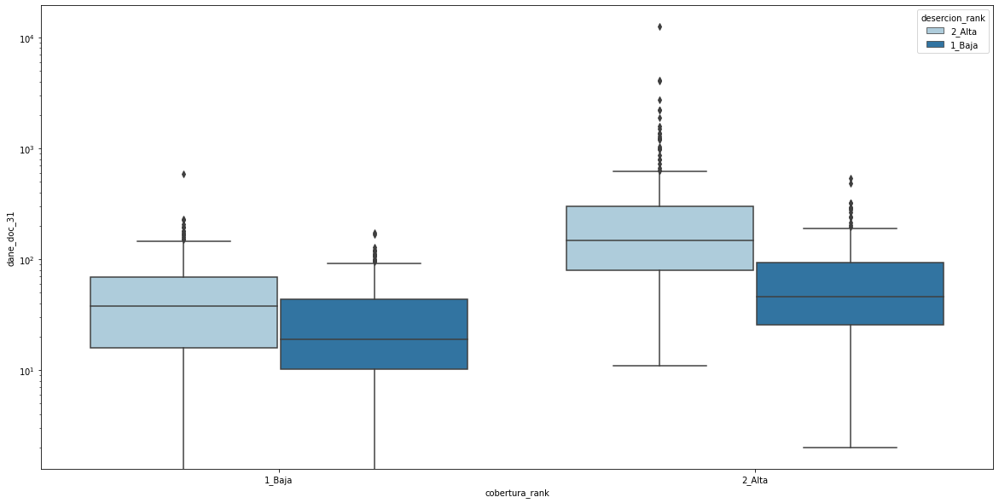

In [27]:
var="dane_doc_31"
fig, axes = plt.subplots(1,1,figsize=(20,10)) # create figure and axes
fig = px.scatter(mun, x=var, y="desertion_perc", width=900,height =350,hover_name='name_municip'
                 ,log_x=True
                 ,color="deser_perc_rank")
fig.show()
#a=sns.violinplot(x="deser_perc_rank", y=var, data=mun, palette="Paired",order=['1_DS_Alta-CB_Baja','2_DS_Baja-CB_Baja','4_DS_Alta-CB_Alta','3_DS_Baja-CB_Alta'])
#a=sns.boxplot(x="deser_perc_rank", y=var, data=mun, palette="Paired",order=['1_DS_Alta-CB_Baja','2_DS_Baja-CB_Baja','4_DS_Alta-CB_Alta','3_DS_Baja-CB_Alta'])
#a=sns.swarmplot(x="deser_perc_rank", y=var, data=mun, palette="Paired",order=['1_DS_Alta-CB_Baja','2_DS_Baja-CB_Baja','4_DS_Alta-CB_Alta','3_DS_Baja-CB_Alta'])
a = sns.boxplot(x="cobertura_rank", y=var, hue="desercion_rank",data=mun, palette="Paired")
a.set_yscale('log')


In [105]:
corr_mat  = X_all.corr()
#sns.heatmap(corr_mat,cmap=sns.diverging_palette(220, 10, as_cmap=True))
#plt.title("Correlation Matrix")
corr_mat.style.background_gradient(cmap='coolwarm')

In [75]:
X.columns

Index(['dane_alu_24', 'dane_doc_02', 'dane_alu_09', 'dane_alu_22',
       'dane_alu_17', 'dane_alu_12', 'dane_doc_28', 'dane_doc_01',
       'dane_doc_04', 'dane_doc_03'],
      dtype='object')

# REVISION DE MODELOS SOLO CON VARIABLES DE PORCENTAJE Y RELATIVAS

Ejecución: 0.34714245796203613 seconds


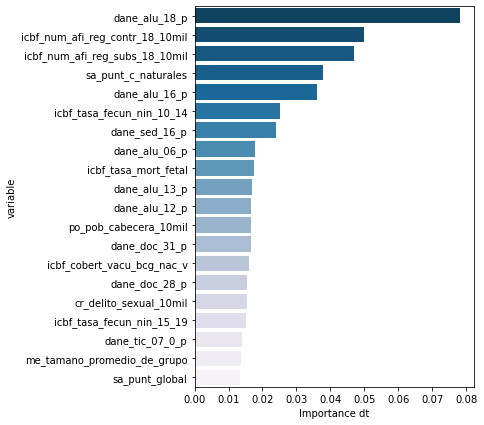

In [28]:
#ARBOL DE DECISION
start_time = time.time()
#Imputar valores faltantes
mun_nomiss=mun.copy()
mun_nomiss=mun_nomiss.fillna(mun_nomiss.median())

vars_drop = list(['name_dept', 'code_dept', 'name_municip', 'code_municip', 'year_cohort'
                  ,'desertion_perc', 'desertion_no', 'latitude', 'longitude', 'region','deser_perc_rank', 'cobertura_rank', 'desercion_rank'
                  ,'me_cobertura_neta'
                  ,'me_desercion_transicion','me_desercion_primaria','me_desercion_secundaria','me_desercion_media'
#Variable que contienen numeros (se quitan para dejar solo aquello que contiene porcentajes)
                  ,'pib_valor_agregado','po_pob_cabecera','po_pob_rural','icbf_num_afi_reg_contr_18','icbf_num_afi_reg_subs_18','dane_alu_01','dane_alu_02','dane_alu_04','dane_alu_05','dane_alu_06','dane_alu_07','dane_alu_08','dane_alu_09','dane_alu_10','dane_alu_11','dane_alu_12','dane_alu_13','dane_alu_14','dane_alu_15','dane_alu_16','dane_alu_17','dane_alu_18','dane_alu_19','dane_alu_20','dane_alu_21','dane_alu_22','dane_alu_23','dane_alu_24','dane_alu_25','dane_doc_01','dane_doc_02','dane_doc_03','dane_doc_04','dane_doc_05','dane_doc_06','dane_doc_07','dane_doc_08','dane_doc_09','dane_doc_10','dane_doc_11','dane_doc_12','dane_doc_13','dane_doc_14','dane_doc_15','dane_doc_16','dane_doc_17','dane_doc_18','dane_doc_19','dane_doc_20','dane_doc_21','dane_doc_22','dane_doc_23','dane_doc_24','dane_doc_25','dane_doc_26','dane_doc_27','dane_doc_28','dane_doc_29','dane_doc_30','dane_doc_31','dane_doc_32','dane_sed_01','dane_sed_02','dane_sed_03','dane_sed_04','dane_sed_05','dane_sed_06','dane_sed_07','dane_sed_08','dane_sed_09','dane_sed_10','dane_sed_11','dane_sed_12','dane_sed_13','dane_tic_03_0','dane_tic_03_1','dane_tic_04_0','dane_tic_04_1','dane_tic_05_0','dane_tic_05_1','dane_tic_06_0','dane_tic_06_1','dane_tic_07_0','dane_tic_07_1','dane_tic_08_0','dane_tic_08_1','dane_tic_10_0','dane_tic_10_1','dane_tic_11_0','dane_tic_11_1','dane_sed_16','dane_sed_17','dane_sed_18','dane_sed_20','dane_sed_23','dane_sed_24','cr_amenaza','cr_delito_sexual','cr_homicidio','cr_hurto_comercio','cr_hurto_persona','cr_hurto_residencia','cr_lesiones_personales','cr_terrorismo','cr_total_crimes','cr_violencia_intrafamiliar','me_aprobacion','me_aprobacion_media','me_aprobacion_primaria','me_aprobacion_secundaria','me_aprobacion_transicion','me_cobertura_bruta','me_cobertura_bruta_media','me_cobertura_bruta_primaria','me_cobertura_bruta_secundaria','me_cobertura_bruta_transicion','me_cobertura_neta','me_cobertura_neta_media','me_cobertura_neta_primaria','me_cobertura_neta_secundaria','me_cobertura_neta_transicion','me_desercion_media','me_desercion_primaria','me_desercion_secundaria','me_desercion_transicion','me_enrolled_students_n','me_poblacion_5_16','me_repitencia_media','me_repitencia_primaria','me_repitencia_secundaria','me_repitencia_transicion','me_reprobacion','me_reprobacion_media','me_reprobacion_primaria','me_reprobacion_secundaria','me_reprobacion_transicion','me_tasa_matriculacion_5_16','po_pob_total','region'
                  ,'dane_doc_12_p','dane_doc_13_p','dane_doc_14_p','dane_doc_15_p','dane_doc_16_p','dane_doc_17_p','dane_doc_18_p','dane_doc_19_p','dane_doc_20_p','dane_doc_21_p','dane_doc_22_p','dane_doc_23_p','dane_doc_24_p','dane_doc_25_p','dane_doc_26_p','dane_doc_27_p'
])


X_all=mun_nomiss.drop(vars_drop, axis=1)

y=mun_nomiss['deser_perc_rank']

clf = DecisionTreeClassifier(random_state=12345)
clf = clf.fit(X_all, y)
features_imp_dt=dict(zip(X_all.columns, clf.feature_importances_))
features_imp_dt=pd.DataFrame.from_dict(features_imp_dt, orient='index').reset_index()
features_imp_dt.rename(columns={'index':'variable',0:'Importance dt'},inplace=True)
features_imp_dt=features_imp_dt.sort_values(by='Importance dt', ascending=False)
features_imp_dt.to_clipboard(index=False,header=True)

# plt.figure(figsize=(10,45))
# ax = sns.barplot(x="Importance dt", y="variable", data=features_imp_dt,palette="PuBu_r")
plt.figure(figsize=(5,7))
ax = sns.barplot(x="Importance dt", y="variable", data=features_imp_dt[0:20],palette="PuBu_r")

print("Ejecución: %s seconds" % (time.time() - start_time))

In [29]:
start_time = time.time()
feature_cols = ['dane_alu_18_p','icbf_num_afi_reg_contr_18_10mil','icbf_num_afi_reg_subs_18_10mil','sa_punt_c_naturales','dane_alu_16_p','icbf_tasa_fecun_nin_10_14','dane_sed_16_p','dane_alu_06_p','icbf_tasa_mort_fetal','dane_alu_13_p']

X = X_all[feature_cols]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=12345)
clf = DecisionTreeClassifier(max_depth=3,random_state=1234)
clf = clf.fit(X_train,y_train)
y_pred_train = clf.predict(X_train)
y_pred_test = clf.predict(X_test)
def multiclass_roc_auc_score(y_test, y_pred, average="macro"):
    lb = LabelBinarizer()
    lb.fit(y_test)
    y_test = lb.transform(y_test)
    y_pred = lb.transform(y_pred)
    return metrics.roc_auc_score(y_test, y_pred, average=average)
print("AUROC train:",multiclass_roc_auc_score(y_train,y_pred_train))
print("AUROC test:",multiclass_roc_auc_score(y_test,y_pred_test))
print("Accuracy train:",metrics.accuracy_score(y_train, y_pred_train))
print("Accuracy test:",metrics.accuracy_score(y_test, y_pred_test))
print("Recall (Sensitivity) train:",metrics.recall_score(y_train, y_pred_train, average=None))
print("Recall (Sensitivity) test:",metrics.recall_score(y_test, y_pred_test, average=None))
print("F1 Score train:",metrics.f1_score(y_train, y_pred_train, average=None))
print("F1 Score test:",metrics.f1_score(y_test, y_pred_test, average=None))
pd.DataFrame(metrics.confusion_matrix(y_pred_test,y_test)).to_clipboard(index=True,header=True)
print("Ejecución: %s seconds" % (time.time() - start_time))

AUROC train: 0.6876937222677281
AUROC test: 0.6400738511143115
Accuracy train: 0.5323660714285714
Accuracy test: 0.45089285714285715
Recall (Sensitivity) train: [0.37440758 0.51943463 0.41326531 0.82524272]
Recall (Sensitivity) test: [0.3220339  0.40277778 0.34782609 0.78723404]
F1 Score train: [0.47590361 0.51669596 0.4229765  0.66929134]
F1 Score test: [0.40860215 0.40559441 0.36363636 0.59677419]
Ejecución: 0.05285811424255371 seconds


# Ajuste de XG-Boost
### Feature selection

Ejecución: 3.1844394207000732 seconds


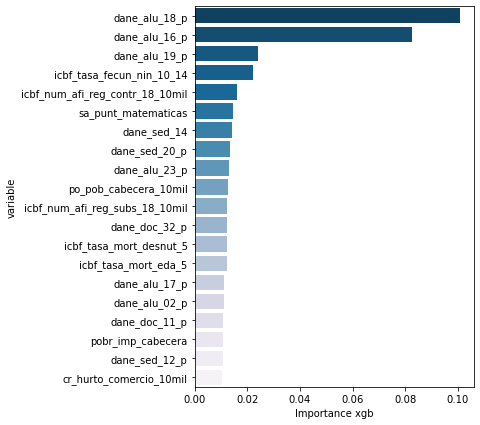

In [30]:
start_time = time.time()
X_all=mun_nomiss.drop(vars_drop, axis=1)

y=mun_nomiss['deser_perc_rank']

# define the model
xgb_model = XGBClassifier(random_state=12345)
# fit the model
xgb_model =xgb_model.fit(X_all, y)
# get importance
 
features_imp_xgb=dict(zip(X_all.columns, xgb_model.feature_importances_))
features_imp_xgb=pd.DataFrame.from_dict(features_imp_xgb, orient='index').reset_index()
features_imp_xgb.rename(columns={'index':'variable',0:'Importance xgb'},inplace=True)
features_imp_xgb=features_imp_xgb.sort_values(by='Importance xgb', ascending=False)
features_imp_xgb.to_clipboard(index=False,header=True)

# plt.figure(figsize=(10,45))
# ax = sns.barplot(x="Importance xgb", y="variable", data=features_imp_xgb,palette="PuBu_r")

plt.figure(figsize=(5,7))
ax = sns.barplot(x="Importance xgb", y="variable", data=features_imp_xgb[0:20],palette="PuBu_r")

print("Ejecución: %s seconds" % (time.time() - start_time))

### Ajuste del modelo

In [31]:
start_time = time.time()
feature_cols = ['dane_alu_18_p','dane_alu_16_p','dane_alu_19_p','icbf_tasa_fecun_nin_10_14','icbf_num_afi_reg_contr_18_10mil','sa_punt_matematicas','dane_sed_14','dane_sed_20_p','dane_alu_23_p','po_pob_cabecera_10mil']


X = X_all[feature_cols]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=12345)

xgb1 = XGBClassifier(random_state=12345)
parameters = {'max_depth':range(3,10,2),
    'min_child_weight':range(1,6,2),
    'learning_rate': [0.0001, 0.001, 0.01, 0.1, 0.2]}

xgb_grid = GridSearchCV(xgb1,parameters,cv = 5,n_jobs = -1,verbose=False)

xgb_grid.fit(X_train,y_train)

print(xgb_grid.best_score_)
print(xgb_grid.best_params_)
print("Ejecución: %s seconds" % (time.time() - start_time))

0.5066977032898821
{'learning_rate': 0.01, 'max_depth': 5, 'min_child_weight': 5}
Ejecución: 61.07043242454529 seconds


In [32]:
start_time = time.time()
X = X_all[feature_cols]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=12345)
xgb = XGBClassifier(random_state=12345,learning_rate=0.01,max_depth=5,min_child_weight=5)
xgb = xgb.fit(X_train,y_train)
y_pred_train = xgb.predict(X_train)
y_pred_test = xgb.predict(X_test)
def multiclass_roc_auc_score(y_test, y_pred, average="macro"):
    lb = LabelBinarizer()
    lb.fit(y_test)
    y_test = lb.transform(y_test)
    y_pred = lb.transform(y_pred)
    return metrics.roc_auc_score(y_test, y_pred, average=average)
print("AUROC train:",multiclass_roc_auc_score(y_train,y_pred_train))
print("AUROC test:",multiclass_roc_auc_score(y_test,y_pred_test))
print("Accuracy train:",metrics.accuracy_score(y_train, y_pred_train))
print("Accuracy test:",metrics.accuracy_score(y_test, y_pred_test))
print("Recall (Sensitivity) train:",metrics.recall_score(y_train, y_pred_train, average=None))
print("Recall (Sensitivity) test:",metrics.recall_score(y_test, y_pred_test, average=None))
print("F1 Score train:",metrics.f1_score(y_train, y_pred_train, average=None))
print("F1 Score test:",metrics.f1_score(y_test, y_pred_test, average=None))
pd.DataFrame(metrics.confusion_matrix(y_pred_test,y_test)).to_clipboard(index=True,header=True)
print("Ejecución: %s seconds" % (time.time() - start_time))

AUROC train: 0.810365038727762
AUROC test: 0.6558017266768799
Accuracy train: 0.7154017857142857
Accuracy test: 0.48214285714285715
Recall (Sensitivity) train: [0.74881517 0.68551237 0.60714286 0.82524272]
Recall (Sensitivity) test: [0.57627119 0.38888889 0.26086957 0.72340426]
F1 Score train: [0.71981777 0.69658887 0.64850136 0.79254079]
F1 Score test: [0.5862069  0.3943662  0.28571429 0.64150943]
Ejecución: 0.49866628646850586 seconds


# Ajuste de Random Forest
### Feature selection

Ejecución: 0.7443203926086426 seconds


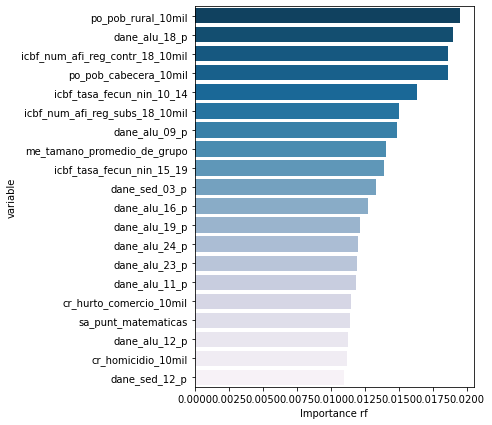

In [33]:
start_time = time.time()
X_all=mun_nomiss.drop(vars_drop, axis=1)

y=mun_nomiss['deser_perc_rank']

# define the model
rf_model = RandomForestClassifier(random_state=12345)
# fit the model
rf_model = rf_model.fit(X_all, y)
# get importance
 
features_imp_rf=dict(zip(X_all.columns, rf_model.feature_importances_))
features_imp_rf=pd.DataFrame.from_dict(features_imp_rf, orient='index').reset_index()
features_imp_rf.rename(columns={'index':'variable',0:'Importance rf'},inplace=True)
features_imp_rf=features_imp_rf.sort_values(by='Importance rf', ascending=False)
features_imp_rf.to_clipboard(index=False,header=True)

# plt.figure(figsize=(10,45))
# ax = sns.barplot(x="Importance rf", y="variable", data=features_imp_rf,palette="PuBu_r")

plt.figure(figsize=(5,7))
ax = sns.barplot(x="Importance rf", y="variable", data=features_imp_rf[0:20],palette="PuBu_r")

print("Ejecución: %s seconds" % (time.time() - start_time))

### Ajuste del modelo

In [34]:
start_time = time.time()
feature_cols = ['po_pob_rural_10mil','me_tamano_promedio_de_grupo','po_pob_cabecera_10mil','dane_alu_18_p','dane_alu_19_p','icbf_num_afi_reg_contr_18_10mil','icbf_tasa_fecun_nin_10_14','icbf_num_afi_reg_subs_18_10mil','dane_sed_03_p','dane_doc_11_p']


X = X_all[feature_cols]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=12345)

rf1 = RandomForestClassifier(random_state=12345)
parameters = {'n_estimators':range(1,100,20),
    'max_depth':range(3,10,2),
    'min_samples_split':range(5,20,5),
    'min_samples_leaf':range(5,20,5)}

rf_grid = GridSearchCV(rf1,parameters,cv = 5,n_jobs = -1,verbose=False)

rf_grid.fit(X_train,y_train)

print(rf_grid.best_score_)
print(rf_grid.best_params_)
print("Ejecución: %s seconds" % (time.time() - start_time))

0.5245685909373059
{'max_depth': 7, 'min_samples_leaf': 10, 'min_samples_split': 5, 'n_estimators': 41}
Ejecución: 35.361106157302856 seconds


In [35]:
start_time = time.time()
X = X_all[feature_cols]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=12345)
rf = RandomForestClassifier(random_state=12345,max_depth= 7, min_samples_leaf= 10, min_samples_split= 5, n_estimators= 41)
rf = rf.fit(X_train,y_train)
y_pred_train = rf.predict(X_train)
y_pred_test = rf.predict(X_test)
def multiclass_roc_auc_score(y_test, y_pred, average="macro"):
    lb = LabelBinarizer()
    lb.fit(y_test)
    y_test = lb.transform(y_test)
    y_pred = lb.transform(y_pred)
    return metrics.roc_auc_score(y_test, y_pred, average=average)
print("AUROC train:",multiclass_roc_auc_score(y_train,y_pred_train))
print("AUROC test:",multiclass_roc_auc_score(y_test,y_pred_test))
print("Accuracy train:",metrics.accuracy_score(y_train, y_pred_train))
print("Accuracy test:",metrics.accuracy_score(y_test, y_pred_test))
print("Recall (Sensitivity) train:",metrics.recall_score(y_train, y_pred_train, average=None))
print("Recall (Sensitivity) test:",metrics.recall_score(y_test, y_pred_test, average=None))
print("F1 Score train:",metrics.f1_score(y_train, y_pred_train, average=None))
print("F1 Score test:",metrics.f1_score(y_test, y_pred_test, average=None))
pd.DataFrame(metrics.confusion_matrix(y_pred_test,y_test)).to_clipboard(index=True,header=True)
print("Ejecución: %s seconds" % (time.time() - start_time))

AUROC train: 0.782502909247063
AUROC test: 0.6802953378272844
Accuracy train: 0.6830357142857143
Accuracy test: 0.53125
Recall (Sensitivity) train: [0.70616114 0.74558304 0.41836735 0.82524272]
Recall (Sensitivity) test: [0.55932203 0.56944444 0.15217391 0.80851064]
F1 Score train: [0.70117647 0.67736758 0.54849498 0.76404494]
F1 Score test: [0.60550459 0.5        0.20289855 0.71698113]
Ejecución: 0.23437070846557617 seconds


In [36]:
features_imp_dt=features_imp_dt.rename_axis('posicion dt').reset_index()
features_imp_dt['posicion dt']=features_imp_dt.index

features_imp_xgb=features_imp_xgb.rename_axis('posicion xgb').reset_index()
features_imp_xgb['posicion xgb']=features_imp_xgb.index

features_imp_rf=features_imp_rf.rename_axis('posicion rf').reset_index()
features_imp_rf['posicion rf']=features_imp_rf.index

features_all=pd.merge(features_imp_dt, features_imp_xgb, how='left', on="variable")
features_all=pd.merge(features_all, features_imp_rf, how='left', on="variable")
features_all['posicion_final']=features_all['posicion dt']+features_all['posicion xgb']+features_all['posicion rf']
features_all=features_all.sort_values(by=['posicion_final'])
features_all[['variable','posicion_final']].to_clipboard(index=False,header=True)

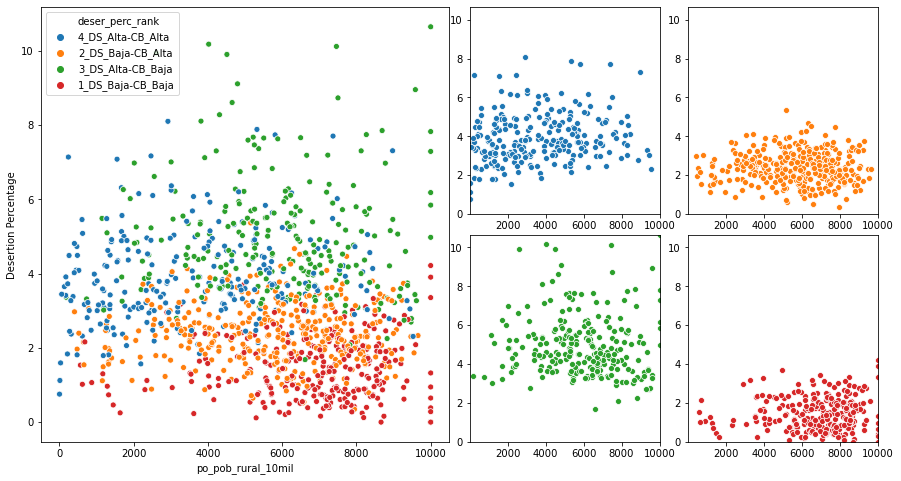

In [37]:
var="po_pob_rural_10mil"
log_scale=False
# fig, axes = plt.subplots(1,1,figsize=(10,5)) # create figure and axes
# fig = px.scatter(mun, x=var, y="desertion_perc", width=900,height =350,hover_name='name_municip'
#                 ,log_x=log_scale
#                 ,color="deser_perc_rank")
# fig.show()

fig = plt.figure(figsize=(15, 8))
outer = gridspec.GridSpec(1, 2, wspace=0.05, hspace=0.1)
inner = gridspec.GridSpecFromSubplotSpec(1, 1,
                    subplot_spec=outer[0], wspace=0.1, hspace=0.1)
ax = plt.Subplot(fig, inner[0])
#t = ax.scatter(mun[var],mun['desertion_perc'],color='darkgrey')
sns.scatterplot(x=var,y='desertion_perc',hue='deser_perc_rank',\
                hue_order=['4_DS_Alta-CB_Alta','2_DS_Baja-CB_Alta','3_DS_Alta-CB_Baja','1_DS_Baja-CB_Baja']\
                ,data=mun,ax=ax)
ax.set_xlabel(var)
ax.set_ylabel('Desertion Percentage')
if log_scale:
    ax.set_xscale('log')
fig.add_subplot(ax)
inner = gridspec.GridSpecFromSubplotSpec(2, 2,
                subplot_spec=outer[1], wspace=0.15, hspace=0.1)
titles=['4_DS_Alta-CB_Alta','2_DS_Baja-CB_Alta','3_DS_Alta-CB_Baja','1_DS_Baja-CB_Baja']
colors=['crimson','green','blue','purple']
for j in range(4):
    ax = plt.Subplot(fig, inner[j])
    #t = ax.scatter(mun.loc[mun.deser_perc_rank==titles[j],var],mun.loc[mun.deser_perc_rank==titles[j],'desertion_perc'],color=colors[j])
    sns.scatterplot(x=var,y='desertion_perc',data=mun[mun.deser_perc_rank==titles[j]],ax=ax,color=sns.color_palette()[j])
    #ax.set_title(titles[j])
    ax.set_xlim(mun[var].min(),mun[var].max())
    ax.set_ylim(mun['desertion_perc'].min(),mun['desertion_perc'].max())
    ax.set_xlabel('')
    ax.set_ylabel('')
    if log_scale:
         ax.set_xscale('log')
    fig.add_subplot(ax)
fig.show()



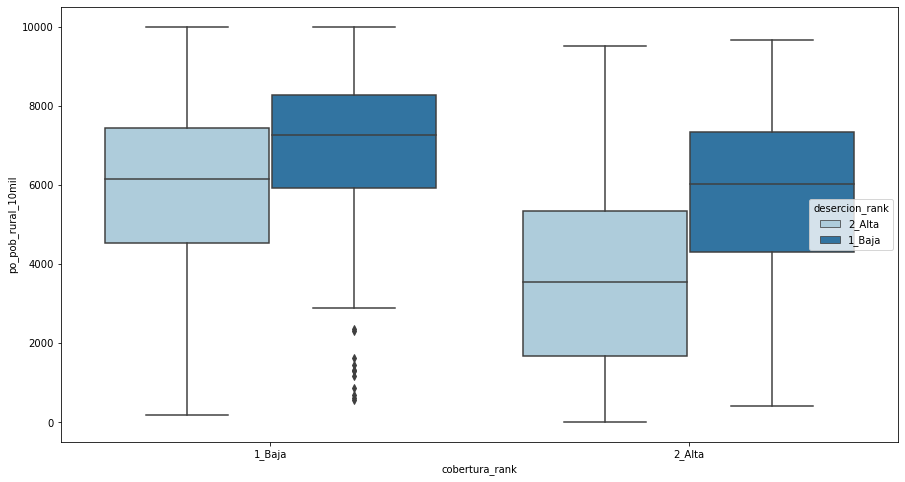

In [112]:
fig = plt.figure(figsize=(15, 8))
a = sns.boxplot(x="cobertura_rank", y=var, hue="desercion_rank",data=mun, palette="Paired")
if log_scale:
    a.set_yscale('log')

In [38]:
corr_mat  = X_all.corr()
#sns.heatmap(corr_mat,cmap=sns.diverging_palette(220, 10, as_cmap=True))
#plt.title("Correlation Matrix")
corr_mat.style.background_gradient(cmap='coolwarm')


# FEATURE SELECTION DENTRO DE CADA UNO DE LOS GRUPOS

In [100]:
start_time = time.time()
#Separar en cada cluster
DS_Baja_CB_Baja=mun_nomiss[mun_nomiss['deser_perc_rank']=='1_DS_Baja-CB_Baja']
DS_Baja_CB_Alta=mun_nomiss[mun_nomiss['deser_perc_rank']=='2_DS_Baja-CB_Alta']
DS_Alta_CB_Baja=mun_nomiss[mun_nomiss['deser_perc_rank']=='3_DS_Alta-CB_Baja']
DS_Alta_CB_Alta=mun_nomiss[mun_nomiss['deser_perc_rank']=='4_DS_Alta-CB_Alta']

vars_drop = list(['name_dept', 'code_dept', 'name_municip', 'code_municip', 'year_cohort'
                  ,'desertion_perc', 'desertion_no', 'latitude', 'longitude', 'region','deser_perc_rank', 'cobertura_rank', 'desercion_rank'
                  ,'me_cobertura_neta'
                  ,'me_desercion_transicion','me_desercion_primaria','me_desercion_secundaria','me_desercion_media'
#Variables con alto missing (mas de 30%)
                  ,'dane_sed_20','dane_sed_20_p','dane_sed_14','icbf_num_nin_adol_desvinc'
#Variables de escalafon docente que se cambiaron por nueva agrupacion (Luis)
                  ,'dane_doc_12_p','dane_doc_13_p','dane_doc_14_p','dane_doc_15_p','dane_doc_16_p','dane_doc_17_p','dane_doc_18_p','dane_doc_19_p','dane_doc_20_p','dane_doc_21_p','dane_doc_22_p','dane_doc_23_p','dane_doc_24_p','dane_doc_25_p','dane_doc_26_p','dane_doc_27_p','dane_doc_12','dane_doc_13','dane_doc_14','dane_doc_15','dane_doc_16','dane_doc_17','dane_doc_18','dane_doc_19','dane_doc_20','dane_doc_21','dane_doc_22','dane_doc_23','dane_doc_24','dane_doc_25','dane_doc_26','dane_doc_27'
#Eliminadas por seleccion una a una:
                  ,'me_reprobacion','me_aprobacion','me_tasa_matriculacion_5_16','me_aprobacion_transicion','dane_alu_11','me_aprobacion_primaria','me_cobertura_bruta','po_pob_total','me_cobertura_neta_secundaria','me_cobertura_neta_primaria','me_aprobacion_secundaria','icbf_num_afi_reg_subs_18','me_aprobacion_media','me_cobertura_bruta_secundaria','dane_sed_10','po_pob_cabecera','me_cobertura_bruta_primaria','me_enrolled_students_n','dane_alu_11_p','dane_alu_09_p','me_poblacion_5_16','dane_sed_03','me_reprobacion_secundaria','dane_sed_08','me_cobertura_bruta_media','me_reprobacion_media','dane_sed_09','dane_alu_23','dane_alu_23_p','me_cobertura_neta_media','dane_alu_01','me_cobertura_neta_transicion','me_cobertura_bruta_transicion','dane_sed_02_p','dane_sed_11','dane_sed_02','me_reprobacion_primaria'

])


## DS_Baja_CB_Baja

Ejecución: 2.3384897708892822 seconds


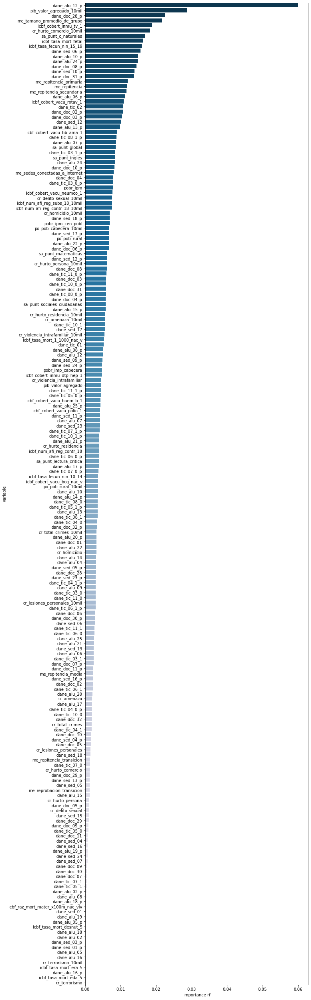

In [101]:
start_time = time.time()
X_all=DS_Baja_CB_Baja.drop(vars_drop, axis=1)

y=DS_Baja_CB_Baja['desertion_perc']

# define the model
rf_model = RandomForestRegressor(random_state=12345)
# fit the model
rf_model = rf_model.fit(X_all, y)
# get importance
 
features_imp_rf=dict(zip(X_all.columns, rf_model.feature_importances_))
features_imp_rf=pd.DataFrame.from_dict(features_imp_rf, orient='index').reset_index()
features_imp_rf.rename(columns={'index':'variable',0:'Importance rf'},inplace=True)
features_imp_rf=features_imp_rf.sort_values(by='Importance rf', ascending=False)
features_imp_rf.to_clipboard(index=False,header=True)

plt.figure(figsize=(10,45))
ax = sns.barplot(x="Importance rf", y="variable", data=features_imp_rf,palette="PuBu_r")

# plt.figure(figsize=(5,7))
# ax = sns.barplot(x="Importance rf", y="variable", data=features_imp_rf[0:20],palette="PuBu_r")

print("Ejecución: %s seconds" % (time.time() - start_time))

## DS_Baja_CB_Alta

Ejecución: 2.739675521850586 seconds


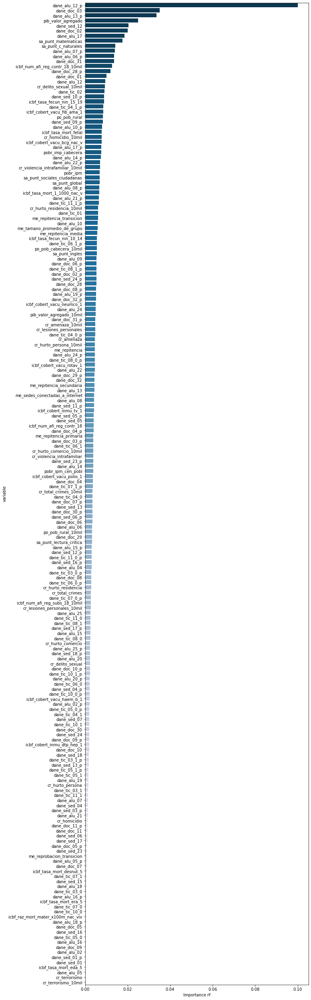

In [102]:
start_time = time.time()
X_all=DS_Baja_CB_Alta.drop(vars_drop, axis=1)

y=DS_Baja_CB_Alta['desertion_perc']

# define the model
rf_model = RandomForestRegressor(random_state=12345)
# fit the model
rf_model = rf_model.fit(X_all, y)
# get importance
 
features_imp_rf=dict(zip(X_all.columns, rf_model.feature_importances_))
features_imp_rf=pd.DataFrame.from_dict(features_imp_rf, orient='index').reset_index()
features_imp_rf.rename(columns={'index':'variable',0:'Importance rf'},inplace=True)
features_imp_rf=features_imp_rf.sort_values(by='Importance rf', ascending=False)
features_imp_rf.to_clipboard(index=False,header=True)

plt.figure(figsize=(10,45))
ax = sns.barplot(x="Importance rf", y="variable", data=features_imp_rf,palette="PuBu_r")

# plt.figure(figsize=(5,7))
# ax = sns.barplot(x="Importance rf", y="variable", data=features_imp_rf[0:20],palette="PuBu_r")

print("Ejecución: %s seconds" % (time.time() - start_time))

## DS_Alta_CB_Baja

Ejecución: 2.295814275741577 seconds


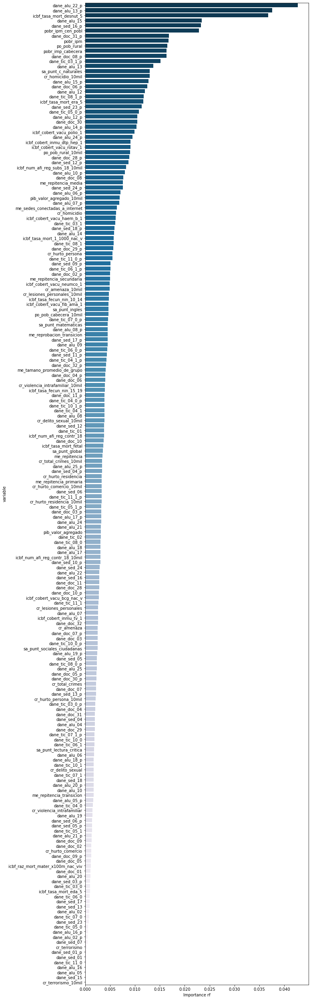

In [103]:
start_time = time.time()
X_all=DS_Alta_CB_Baja.drop(vars_drop, axis=1)

y=DS_Alta_CB_Baja['desertion_perc']

# define the model
rf_model = RandomForestRegressor(random_state=12345)
# fit the model
rf_model = rf_model.fit(X_all, y)
# get importance
 
features_imp_rf=dict(zip(X_all.columns, rf_model.feature_importances_))
features_imp_rf=pd.DataFrame.from_dict(features_imp_rf, orient='index').reset_index()
features_imp_rf.rename(columns={'index':'variable',0:'Importance rf'},inplace=True)
features_imp_rf=features_imp_rf.sort_values(by='Importance rf', ascending=False)
features_imp_rf.to_clipboard(index=False,header=True)

plt.figure(figsize=(10,45))
ax = sns.barplot(x="Importance rf", y="variable", data=features_imp_rf,palette="PuBu_r")

# plt.figure(figsize=(5,7))
# ax = sns.barplot(x="Importance rf", y="variable", data=features_imp_rf[0:20],palette="PuBu_r")

print("Ejecución: %s seconds" % (time.time() - start_time))

## DS_Alta_CB_Alta

Ejecución: 2.1903960704803467 seconds


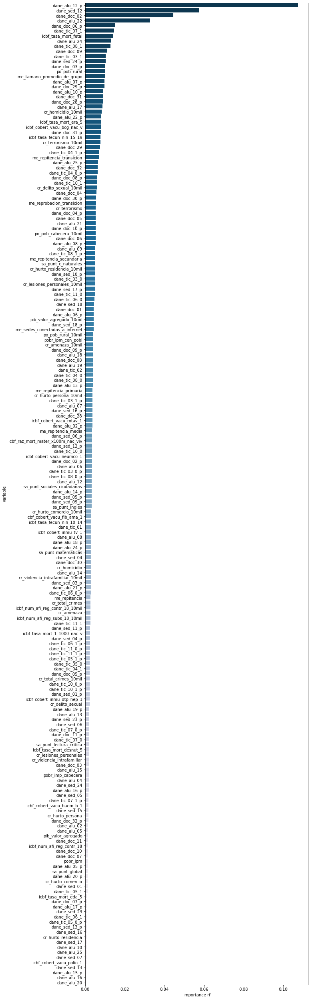

In [104]:
start_time = time.time()
X_all=DS_Alta_CB_Alta.drop(vars_drop, axis=1)

y=DS_Alta_CB_Alta['desertion_perc']

# define the model
rf_model = RandomForestRegressor(random_state=12345)
# fit the model
rf_model = rf_model.fit(X_all, y)
# get importance
 
features_imp_rf=dict(zip(X_all.columns, rf_model.feature_importances_))
features_imp_rf=pd.DataFrame.from_dict(features_imp_rf, orient='index').reset_index()
features_imp_rf.rename(columns={'index':'variable',0:'Importance rf'},inplace=True)
features_imp_rf=features_imp_rf.sort_values(by='Importance rf', ascending=False)
features_imp_rf.to_clipboard(index=False,header=True)

plt.figure(figsize=(10,45))
ax = sns.barplot(x="Importance rf", y="variable", data=features_imp_rf,palette="PuBu_r")

# plt.figure(figsize=(5,7))
# ax = sns.barplot(x="Importance rf", y="variable", data=features_imp_rf[0:20],palette="PuBu_r")

print("Ejecución: %s seconds" % (time.time() - start_time))

In [105]:

var="me_tamano_promedio_de_grupo"

x0 = DS_Baja_CB_Baja[var]
x1 = DS_Baja_CB_Alta[var]
x2 = DS_Alta_CB_Baja[var]
x3 = DS_Alta_CB_Alta[var]

hist_data = [x0, x1, x2, x3]

group_labels = ['1_DS_Baja_CB_Baja', '2_DS_Baja_CB_Alta', '3_DS_Alta_CB_Baja' ,'4_DS_Alta_CB_Alta']
colors = ['#05386B', '#379683', '#5CDB95','#8EE4AF']

# Create distplot with curve_type set to 'normal'
fig = ff.create_distplot(hist_data, group_labels, show_hist=False, colors=colors,show_rug=False)

# Add title
#fig.update_layout(title_text='')
fig.show()

### Imputar valores faltantes

In [60]:
#Mantener solo columnas con bajo % de missing
mun_nomiss=mun.copy()

vars_drop = list(['cr_terrorismo','icbf_cobert_inmu_dtp_hep_1','icbf_cobert_inmu_tv_1','icbf_cobert_vacu_bcg_nac_v','icbf_cobert_vacu_fib_ama_1','icbf_cobert_vacu_haem_b_1','icbf_cobert_vacu_neumco_1','icbf_cobert_vacu_polio_1','icbf_cobert_vacu_rotav_1','icbf_num_afi_reg_contr_18','icbf_num_afi_reg_subs_18','icbf_num_nin_adol_desvinc','icbf_raz_mort_mater_x100m_nac_viv','icbf_tasa_fecun_nin_10_14','icbf_tasa_fecun_nin_15_19','icbf_tasa_mort_1_1000_nac_v','icbf_tasa_mort_fetal','icbf_tasa_mort_desnut_5','icbf_tasa_mort_eda_5','icbf_tasa_mort_era_5','me_tamano_promedio_de_grupo','me_sedes_conectadas_a_internet','pib_valor_agregado','dane_tic_11','dane_sed_20','dane_sed_21','dane_sed_14'])
mun_nomiss.drop(vars_drop, axis=1, inplace=True)
mun_nomiss.shape

#Por ahora se imputan los valores faltantes usando la mediana de cada variable. 
#Se debe evaluar si es la mejor forma de imputación o se debe usar otra
mun_nomiss=mun_nomiss.fillna(mun_nomiss.median())

C:\Users\Daniel_Jimenez\Documents\programas_Data_science\Anaconda\envs\desertion_project\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


Exception ignored in: <function _ConnectionRecord.checkout.<locals>.<lambda> at 0x000001F07409BDC8>
Traceback (most recent call last):
  File "C:\Users\Daniel_Jimenez\Documents\programas_Data_science\Anaconda\envs\desertion_project\lib\site-packages\sqlalchemy\pool\base.py", line 506, in <lambda>
    and _finalize_fairy(None, rec, pool, ref, echo),
  File "C:\Users\Daniel_Jimenez\Documents\programas_Data_science\Anaconda\envs\desertion_project\lib\site-packages\sqlalchemy\pool\base.py", line 714, in _finalize_fairy
    connection_record.checkin()
  File "C:\Users\Daniel_Jimenez\Documents\programas_Data_science\Anaconda\envs\desertion_project\lib\site-packages\sqlalchemy\pool\base.py", line 528, in checkin
    finalizer(connection)
  File "C:\Users\Daniel_Jimenez\Documents\programas_Data_science\Anaconda\envs\desertion_project\lib\site-packages\sqlalchemy\engine\default.py", line 605, in reset_isolation_level
    self.set_isolation_level(dbapi_conn, self.default_isolation_level)
  File 

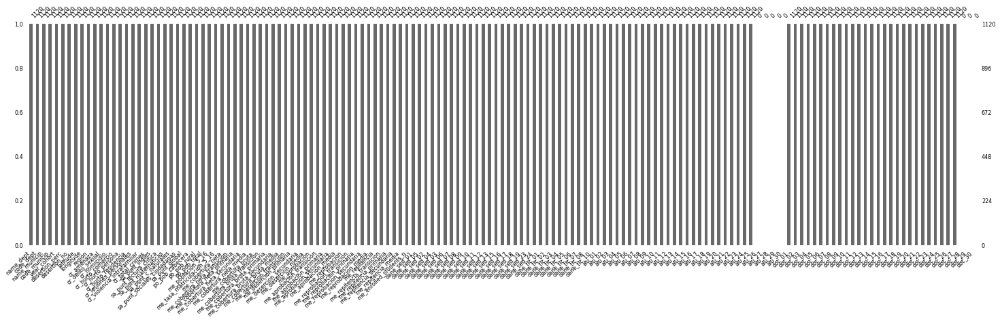

In [61]:
msno.bar(mun_nomiss, labels=True, figsize=(25,6), fontsize=8)

### Inspeccionar valores atipicos

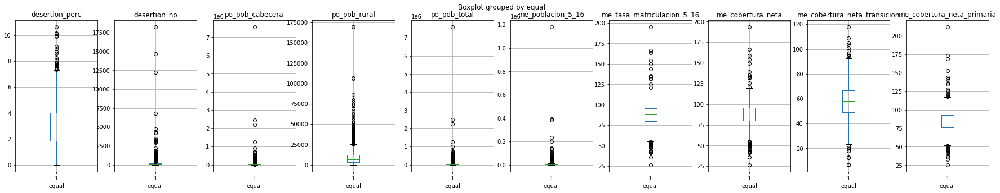

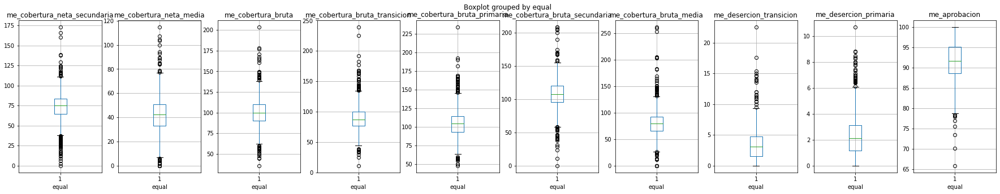

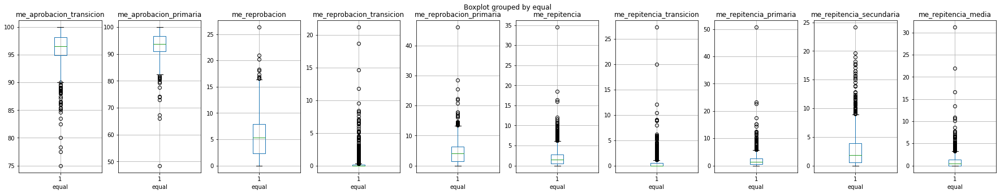

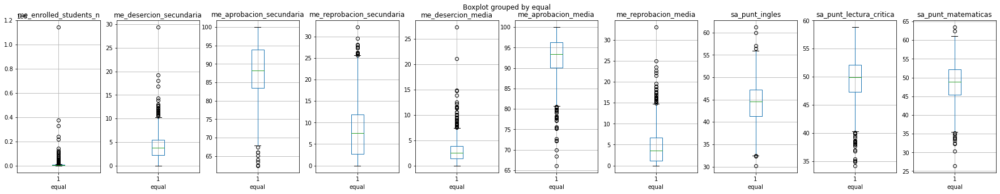

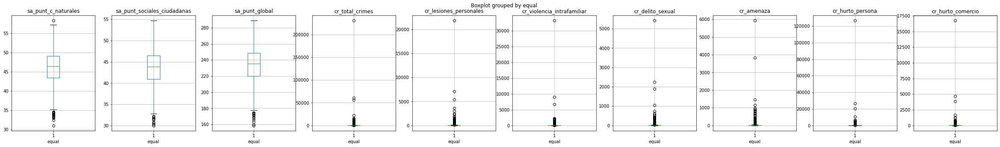

In [9]:
vars_boxplot=list(['desertion_perc','desertion_no','po_pob_cabecera','po_pob_rural','po_pob_total','me_poblacion_5_16','me_tasa_matriculacion_5_16','me_cobertura_neta','me_cobertura_neta_transicion','me_cobertura_neta_primaria','me_cobertura_neta_secundaria','me_cobertura_neta_media','me_cobertura_bruta','me_cobertura_bruta_transicion','me_cobertura_bruta_primaria','me_cobertura_bruta_secundaria','me_cobertura_bruta_media','me_desercion_transicion','me_desercion_primaria','me_aprobacion','me_aprobacion_transicion','me_aprobacion_primaria','me_reprobacion','me_reprobacion_transicion','me_reprobacion_primaria','me_repitencia','me_repitencia_transicion','me_repitencia_primaria','me_repitencia_secundaria','me_repitencia_media','me_enrolled_students_n','me_desercion_secundaria','me_aprobacion_secundaria','me_reprobacion_secundaria','me_desercion_media','me_aprobacion_media','me_reprobacion_media','sa_punt_ingles','sa_punt_lectura_critica','sa_punt_matematicas','sa_punt_c_naturales','sa_punt_sociales_ciudadanas','sa_punt_global','cr_total_crimes','cr_lesiones_personales','cr_violencia_intrafamiliar','cr_delito_sexual','cr_amenaza','cr_hurto_persona','cr_hurto_comercio','cr_hurto_residencia','cr_homicidio'])
#vars_boxplot=list(['desertion_perc','desertion_no','po_pob_cabecera','po_pob_rural'])
mun_nomiss['equal']=1

fig, ax = plt.subplots(1, 10, figsize=(30, 5))
for i in range(0, 10):
    mun_nomiss.boxplot(vars_boxplot[i],'equal', ax=ax[i])    
fig, ax = plt.subplots(1, 10, figsize=(30, 5))
for i in range(0, 10):
    mun_nomiss.boxplot(vars_boxplot[i+10],'equal', ax=ax[i])    
fig, ax = plt.subplots(1, 10, figsize=(30, 5))
for i in range(0, 10):
    mun_nomiss.boxplot(vars_boxplot[i+20],'equal', ax=ax[i])    
fig, ax = plt.subplots(1, 10, figsize=(30, 5))
for i in range(0, 10):
    mun_nomiss.boxplot(vars_boxplot[i+30],'equal', ax=ax[i])    
fig, ax = plt.subplots(1, 10, figsize=(40, 5))
for i in range(0, 10):
    mun_nomiss.boxplot(vars_boxplot[i+40],'equal', ax=ax[i])

### Acotar variables por valores atípicos (percentiles 5 y 95)

In [10]:
percentile_df = mun_nomiss.set_index(['name_dept', 'code_dept', 'name_municip', 'code_municip', 'year_cohort', 'latitude', 'longitude', 'region']).apply(lambda x: np.clip(x, *np.percentile(x, [5,95]))).reset_index()

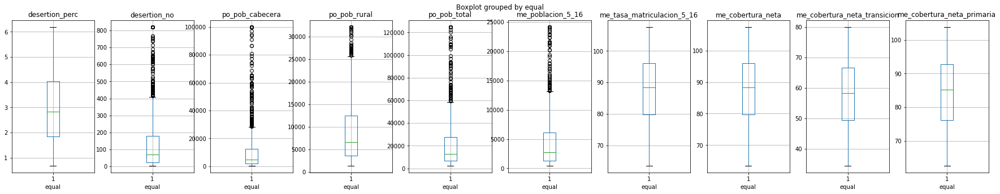

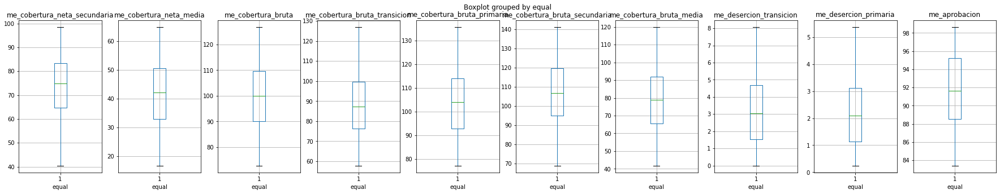

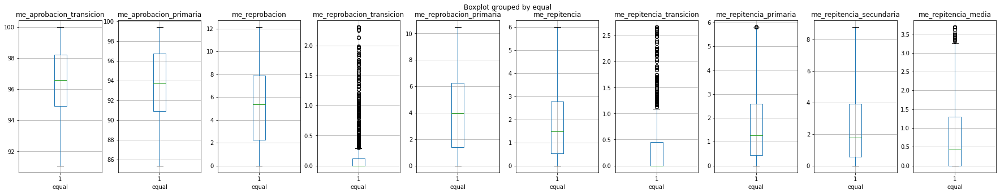

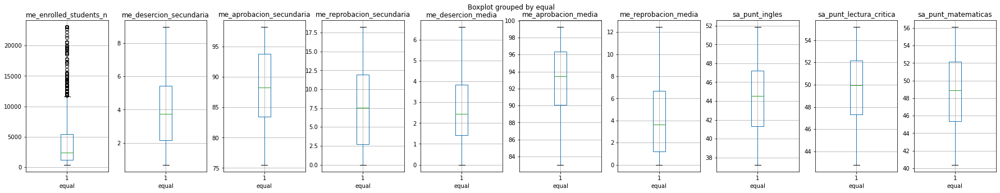

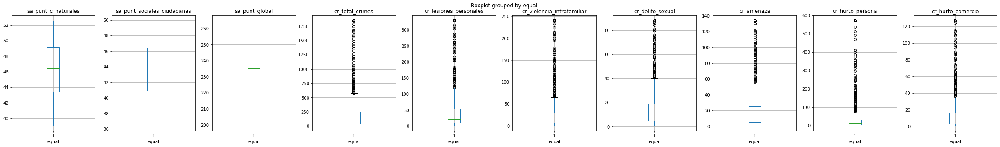

In [11]:
fig, ax = plt.subplots(1, 10, figsize=(30, 5))
for i in range(0, 10):
    percentile_df.boxplot(vars_boxplot[i],'equal', ax=ax[i])    
fig, ax = plt.subplots(1, 10, figsize=(30, 5))
for i in range(0, 10):
    percentile_df.boxplot(vars_boxplot[i+10],'equal', ax=ax[i])    
fig, ax = plt.subplots(1, 10, figsize=(30, 5))
for i in range(0, 10):
    percentile_df.boxplot(vars_boxplot[i+20],'equal', ax=ax[i])    
fig, ax = plt.subplots(1, 10, figsize=(30, 5))
for i in range(0, 10):
    percentile_df.boxplot(vars_boxplot[i+30],'equal', ax=ax[i])    
fig, ax = plt.subplots(1, 10, figsize=(40, 5))
for i in range(0, 10):
    percentile_df.boxplot(vars_boxplot[i+40],'equal', ax=ax[i])

### Rankear deserción usando Kmeans (Alto, Medio, Bajo)

In [12]:
mun_nomiss.columns

Index(['name_dept', 'code_dept', 'name_municip', 'code_municip', 'year_cohort',
       'desertion_perc', 'desertion_no', 'latitude', 'longitude', 'region',
       'cr_amenaza', 'cr_delito_sexual', 'cr_homicidio', 'cr_hurto_comercio',
       'cr_hurto_persona', 'cr_hurto_residencia', 'cr_lesiones_personales',
       'cr_violencia_intrafamiliar', 'cr_total_crimes', 'sa_punt_ingles',
       'sa_punt_lectura_critica', 'sa_punt_matematicas', 'sa_punt_c_naturales',
       'sa_punt_sociales_ciudadanas', 'sa_punt_global', 'po_pob_cabecera',
       'po_pob_rural', 'po_pob_total', 'me_poblacion_5_16',
       'me_tasa_matriculacion_5_16', 'me_cobertura_neta',
       'me_cobertura_neta_transicion', 'me_cobertura_neta_primaria',
       'me_cobertura_neta_secundaria', 'me_cobertura_neta_media',
       'me_cobertura_bruta', 'me_cobertura_bruta_transicion',
       'me_cobertura_bruta_primaria', 'me_cobertura_bruta_secundaria',
       'me_cobertura_bruta_media', 'me_desercion_transicion',
       'me_de

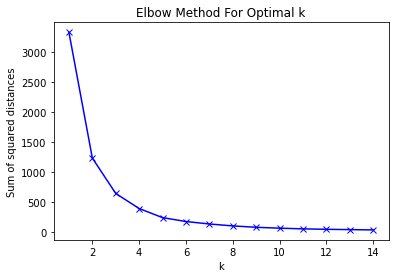

In [13]:
#Usar solo la desercion
desertion=pd.DataFrame(mun_nomiss['desertion_perc'])
#Número de cluster óptimo
Sum_of_squared_distances = []
K = range(1,15)
for k in K:
    km = KMeans(n_clusters=k, random_state=12345)
    km = km.fit(desertion)
    Sum_of_squared_distances.append(km.inertia_)

plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum of squared distances')
plt.title('Elbow Method For Optimal k')
plt.show()

C:\Users\Daniel_Jimenez\Documents\programas_Data_science\Anaconda\envs\desertion_project\lib\site-packages\numpy\core\_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


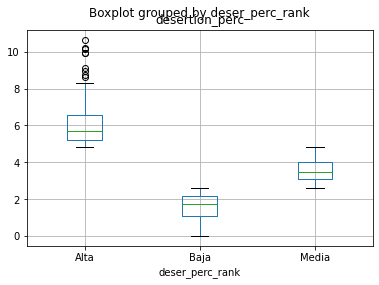

In [14]:
#Ajustar Kmeans con 3 grupos
km = KMeans(n_clusters=3, random_state=12345).fit(desertion)
mun_nomiss['deser_perc_rank']=km.labels_
mun_nomiss['deser_perc_rank']=np.where(mun_nomiss['deser_perc_rank'] == 1, 'Baja'
                                       , np.where(mun_nomiss['deser_perc_rank'] == 0, 'Media','Alta'))
mun_nomiss.boxplot('desertion_perc','deser_perc_rank')

# Ajuste de árbol de decisión 
### Feature selection

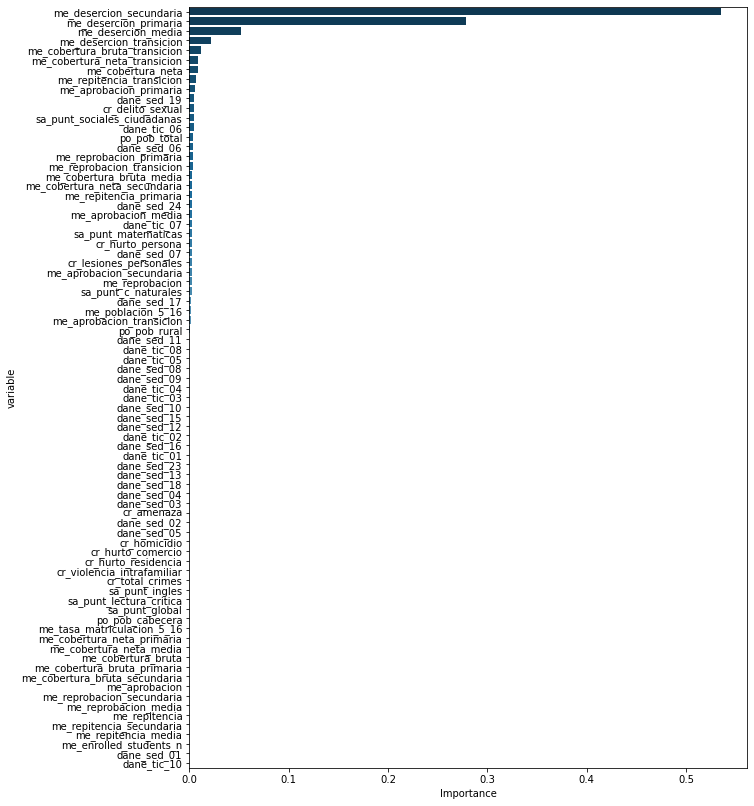

In [15]:
vars_drop = list(['name_dept', 'code_dept', 'name_municip', 'code_municip', 'year_cohort',
       'desertion_perc', 'desertion_no', 'latitude', 'longitude', 'region','equal','deser_perc_rank'])
X_all=mun_nomiss.drop(vars_drop, axis=1)

y=mun_nomiss['deser_perc_rank']

clf = DecisionTreeClassifier(random_state=12345)
clf = clf.fit(X_all, y)
features_imp=dict(zip(X_all.columns, clf.feature_importances_))
features_imp=pd.DataFrame.from_dict(features_imp, orient='index').reset_index()
features_imp.rename(columns={'index':'variable',0:'Importance'},inplace=True)
features_imp=features_imp.sort_values(by='Importance', ascending=False)
features_imp.to_clipboard(index=False,header=True)

plt.figure(figsize=(10,14))
ax = sns.barplot(x="Importance", y="variable", data=features_imp,palette="PuBu_r")

### Ajuste del modelo

In [26]:
feature_cols = ['me_desercion_secundaria','me_desercion_primaria','me_desercion_media','me_desercion_transicion','me_cobertura_bruta_transicion']
X = X_all[feature_cols]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=12345)
clf = DecisionTreeClassifier(max_depth=3)
clf = clf.fit(X_train,y_train)
y_pred_train = clf.predict(X_train)
y_pred_test = clf.predict(X_test)
def multiclass_roc_auc_score(y_test, y_pred, average="macro"):
    lb = LabelBinarizer()
    lb.fit(y_test)
    y_test = lb.transform(y_test)
    y_pred = lb.transform(y_pred)
    return metrics.roc_auc_score(y_test, y_pred, average=average)
print("AUROC train:",multiclass_roc_auc_score(y_train,y_pred_train))
print("AUROC test:",multiclass_roc_auc_score(y_test,y_pred_test))
print("Accuracy train:",metrics.accuracy_score(y_train, y_pred_train))
print("Accuracy test:",metrics.accuracy_score(y_test, y_pred_test))
print("Recall (Sensitivity) train:",metrics.recall_score(y_train, y_pred_train, average=None))
print("Recall (Sensitivity) test:",metrics.recall_score(y_test, y_pred_test, average=None))
print("F1 Score train:",metrics.f1_score(y_train, y_pred_train, average=None))
print("F1 Score test:",metrics.f1_score(y_test, y_pred_test, average=None))
pd.DataFrame(metrics.confusion_matrix(y_pred_test,y_test)).to_clipboard(index=True,header=True)

AUROC train: 0.8887300377702755
AUROC test: 0.8796153193735702
Accuracy train: 0.8872767857142857
Accuracy test: 0.8794642857142857
Recall (Sensitivity) train: [0.68613139 0.99002494 0.84916201]
Recall (Sensitivity) test: [0.66666667 0.96039604 0.86021505]
F1 Score train: [0.79661017 0.93742621 0.85754584]
F1 Score test: [0.78431373 0.92380952 0.85561497]


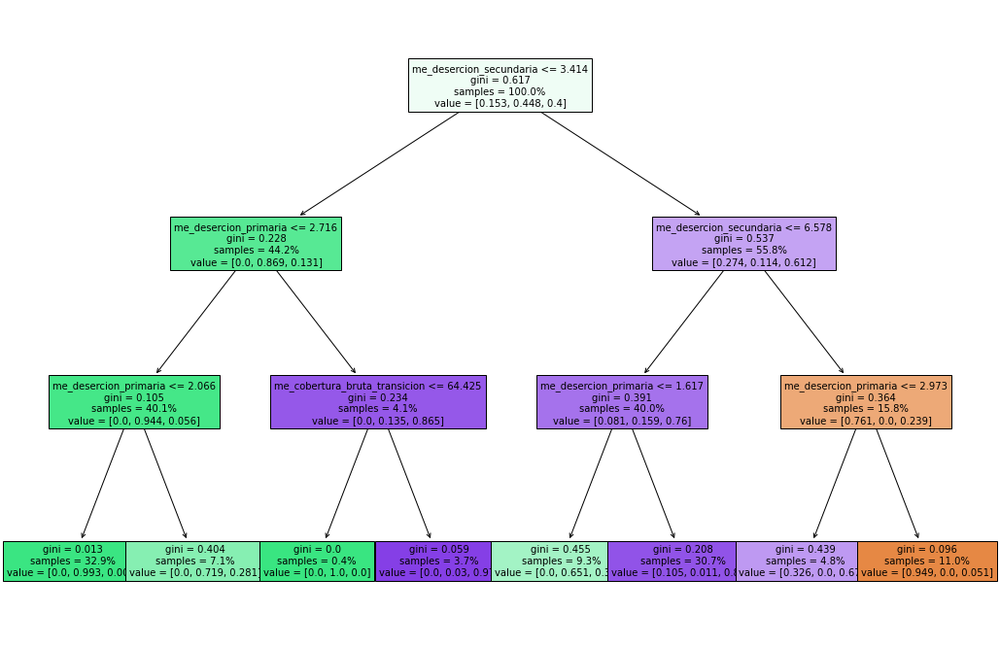

In [22]:
fig, ax = plt.subplots(figsize=(18, 12))
tree.plot_tree(clf, max_depth=4, fontsize=10,feature_names=feature_cols,filled=True,proportion=True)
plt.show()

### Caracterización

In [23]:
categ=np.floor(X[X.columns].rank() / len(X) / .3).astype(int) + 1
categ.columns = [str(col) + '_cat' for col in categ.columns]
result = pd.concat([X, categ], axis=1, sort=False)
result=pd.concat([result, pd.DataFrame(y)], axis=1, sort=False)
result

,me_desercion_secundaria,me_desercion_primaria,me_desercion_media,me_desercion_transicion,me_cobertura_bruta_transicion,me_desercion_secundaria_cat,me_desercion_primaria_cat,me_desercion_media_cat,me_desercion_transicion_cat,me_cobertura_bruta_transicion_cat,deser_perc_rank
0,5.2982,3.1019,2.6897,3.6600,94.8486,3,3,2,3,3,Media
1,4.9600,1.8908,3.9813,2.6786,81.7518,3,2,3,2,2,Media
2,0.0000,0.6250,2.1277,0.0000,66.6667,1,1,2,1,1,Baja
3,3.4965,1.3423,1.1765,3.3333,74.0741,2,2,1,2,1,Baja
4,8.8398,3.4630,2.8139,3.2641,83.2099,4,3,2,2,2,Alta
...,...,...,...,...,...,...,...,...,...,...,...
1115,4.0000,0.0000,4.5455,0.0000,54.2857,2,1,3,1,1,Baja
1116,8.4584,6.7771,3.9474,8.1365,105.4762,4,4,3,4,3,Alta
1117,2.7295,4.9435,0.4184,5.6250,80.4020,2,4,1,3,2,Media
1118,6.5421,3.9931,0.0000,3.4483,70.7317,3,3,1,2,1,Media


In [20]:
pd.crosstab(result['me_desercion_secundaria_cat'],result['deser_perc_rank']).to_clipboard(index=True,header=True)

result.groupby(['me_desercion_secundaria_cat']).agg({'me_desercion_secundaria':[min,max]})

me_desercion_secundaria         
                                                min      max
me_desercion_secundaria_cat                                 
1                                            0.0000   2.5063
2                                            2.5192   4.2596
3                                            4.2623   7.5881
4                                            7.6284  29.4118

In [21]:
pd.crosstab(result['me_desercion_primaria_cat'],result['deser_perc_rank']).to_clipboard(index=True,header=True)

result.groupby(['me_desercion_primaria_cat']).agg({'me_desercion_primaria':[min,max]})

me_desercion_primaria         
                                            min      max
me_desercion_primaria_cat                               
1                                        0.0000   1.3228
2                                        1.3298   2.4569
3                                        2.4581   4.3333
4                                        4.3414  10.6911

In [22]:
pd.crosstab(result['me_desercion_media_cat'],result['deser_perc_rank']).to_clipboard(index=True,header=True)

result.groupby(['me_desercion_media_cat']).agg({'me_desercion_media':[min,max]})

me_desercion_media         
                                      min      max
me_desercion_media_cat                            
1                                  0.0000   1.6484
2                                  1.6502   2.9070
3                                  2.9155   5.4645
4                                  5.4762  27.2727

In [23]:
pd.crosstab(result['me_desercion_transicion_cat'],result['deser_perc_rank']).to_clipboard(index=True,header=True)

result.groupby(['me_desercion_transicion_cat']).agg({'me_desercion_transicion':[min,max]})

me_desercion_transicion         
                                                min      max
me_desercion_transicion_cat                                 
1                                            0.0000   1.8868
2                                            1.8939   3.6364
3                                            3.6394   6.5574
4                                            6.5728  22.5309

In [24]:
pd.crosstab(result['me_cobertura_bruta_transicion_cat'],result['deser_perc_rank']).to_clipboard(index=True,header=True)

result.groupby(['me_cobertura_bruta_transicion_cat']).agg({'me_cobertura_bruta_transicion':[min,max]})

me_cobertura_bruta_transicion          
                                                            min       max
me_cobertura_bruta_transicion_cat                                        
1                                                       11.2500   78.0172
2                                                       78.1553   91.3636
3                                                       91.4724  114.3491
4                                                      114.7059  239.1304

# Ajuste de XG-Boost
### Feature selection

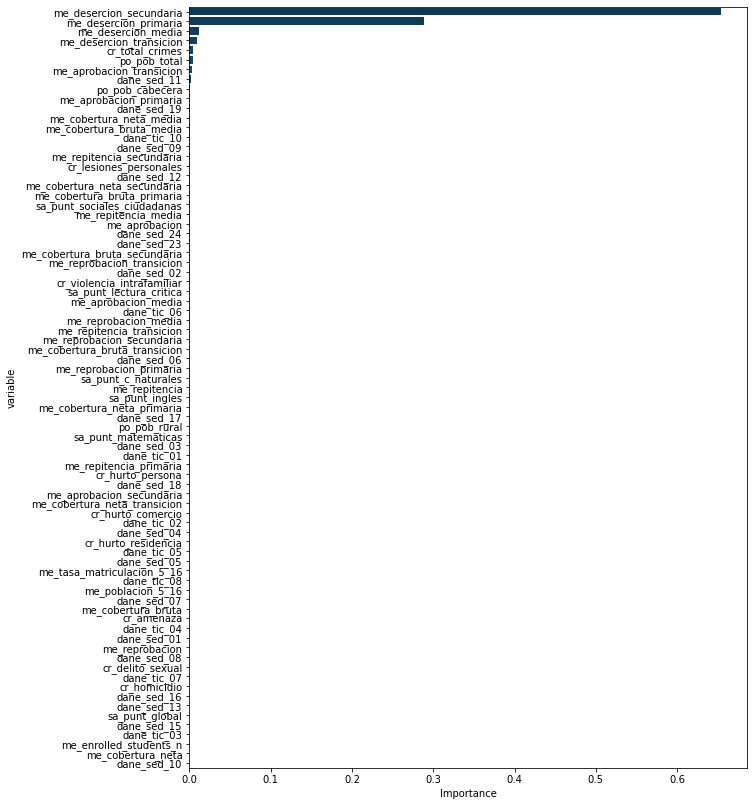

In [26]:
X_all=mun_nomiss.drop(vars_drop, axis=1)

y=mun_nomiss['desertion_perc']

# define the model
xgb_model = XGBRegressor()
# fit the model
xgb_model.fit(X_all, y)
# get importance
 
features_imp=dict(zip(X_all.columns, xgb_model.feature_importances_))
features_imp=pd.DataFrame.from_dict(features_imp, orient='index').reset_index()
features_imp.rename(columns={'index':'variable',0:'Importance'},inplace=True)
features_imp=features_imp.sort_values(by='Importance', ascending=False)
features_imp.to_clipboard(index=False,header=True)

plt.figure(figsize=(10,14))
ax = sns.barplot(x="Importance", y="variable", data=features_imp,palette="PuBu_r")


### Ajuste del modelo

In [116]:
feature_cols = ['me_desercion_secundaria','me_desercion_primaria','me_desercion_media','me_desercion_transicion','po_pob_total','cr_total_crimes']

X = X_all[feature_cols]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=12345)

xgb1 = XGBRegressor()
parameters = {'max_depth':range(3,10,2),
    'min_child_weight':range(1,6,2),
    'learning_rate': [0.0001, 0.001, 0.01, 0.1, 0.2]}

xgb_grid = GridSearchCV(xgb1,parameters,cv = 5,n_jobs = -1,verbose=False)

xgb_grid.fit(X_train,y_train)

print(xgb_grid.best_score_)
print(xgb_grid.best_params_)

0.9850067973303609
{'learning_rate': 0.2, 'max_depth': 3, 'min_child_weight': 1}


MAE train: 0.07243547185329456
MAE test: 0.15899776266217233
RMSE train: 0.09415071664369376
RMSE test: 0.2638882198314687
R-Squared train: 0.9971401256032681
R-Squared test: 0.9714036755229484


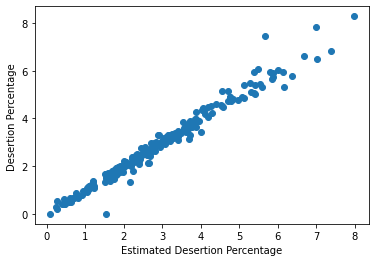

In [120]:
xbg_model = XGBRegressor(random_state=12345,learning_rate=0.2,max_depth=3,min_child_weight=1)
xbg_model = xbg_model.fit(X_train,y_train)
y_pred_train = xbg_model.predict(X_train)
y_pred_test = xbg_model.predict(X_test)

MAPE_train=np.mean(np.abs((y_train - y_pred_train) / (y_train))) * 100
MAPE_test=np.mean(np.abs((y_test - y_pred_test) / (y_test))) * 100
MAE_train=metrics.mean_absolute_error(y_train, y_pred_train)
MAE_test=metrics.mean_absolute_error(y_test, y_pred_test)
RMSE_train=np.sqrt(metrics.mean_squared_error(y_train, y_pred_train))
RMSE_test=np.sqrt(metrics.mean_squared_error(y_test, y_pred_test))
R2_train=metrics.r2_score(y_train, y_pred_train)
R2_test=metrics.r2_score(y_test, y_pred_test)

#print("MAPE train:",MAPE_train)
#print("MAPE test:",MAPE_test)
print("MAE train:",MAE_train)
print("MAE test:",MAE_test)
print("RMSE train:",RMSE_train)
print("RMSE test:",RMSE_test)
print("R-Squared train:",R2_train)
print("R-Squared test:",R2_test)

plt.scatter(y_pred_test, y_test)
plt.xlabel("Estimated Desertion Percentage")
plt.ylabel("Desertion Percentage ")
plt.show()


In [ ]:
# Load list of points for cluster analysis.
sample = read_sample(FCPS_SAMPLES.SAMPLE_TWO_DIAMONDS)
# Create instance of K-Medians algorithm.
initial_medians = [[0.0, 0.1], [2.5, 0.7], [1.5, 0.2]]
kmedians_instance = kmedians(sample, initial_medians)
# Run cluster analysis and obtain results.
kmedians_instance.process()
clusters = kmedians_instance.get_clusters()
medians = kmedians_instance.process()
# Visualize clustering results.
visualizer = cluster_visualizer()
visualizer.append_clusters(clusters, sample)
visualizer.append_cluster(initial_medians, marker='*', markersize=10)
visualizer.append_cluster(medians, marker='*', markersize=10)
visualizer.show()